# Afriat

In [1]:
scan=0.1375

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2544,3296,9403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2544,2562,1682,3444,1630,3381
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4465,10778
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 661,813,2336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 661,640,426,846,419,818
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1119,2691
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:22:57, 14.32s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:22:57, 14.32s/it, v_num=1, total_loss_train=3.69e+3, kl_local_train=41.6]

Epoch 2/600:   0%|          | 1/600 [00:14<2:22:57, 14.32s/it, v_num=1, total_loss_train=3.69e+3, kl_local_train=41.6]

Epoch 2/600:   0%|          | 2/600 [00:27<2:15:03, 13.55s/it, v_num=1, total_loss_train=3.69e+3, kl_local_train=41.6]

Epoch 2/600:   0%|          | 2/600 [00:27<2:15:03, 13.55s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=57.3]

Epoch 3/600:   0%|          | 2/600 [00:27<2:15:03, 13.55s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=57.3]

Epoch 3/600:   0%|          | 3/600 [00:40<2:12:33, 13.32s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=57.3]

Epoch 3/600:   0%|          | 3/600 [00:40<2:12:33, 13.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=56.5] 

Epoch 4/600:   0%|          | 3/600 [00:40<2:12:33, 13.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=56.5]

Epoch 4/600:   1%|          | 4/600 [00:53<2:10:45, 13.16s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=56.5]

Epoch 4/600:   1%|          | 4/600 [00:53<2:10:45, 13.16s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=52.4]

Epoch 5/600:   1%|          | 4/600 [00:53<2:10:45, 13.16s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=52.4]

Epoch 5/600:   1%|          | 5/600 [01:06<2:10:13, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=52.4]

Epoch 5/600:   1%|          | 5/600 [01:06<2:10:13, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=45.8]

Epoch 6/600:   1%|          | 5/600 [01:07<2:10:13, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=45.8]

Epoch 6/600:   1%|          | 6/600 [01:19<2:11:35, 13.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=45.8]

Epoch 6/600:   1%|          | 6/600 [01:19<2:11:35, 13.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 6/600 [01:19<2:11:35, 13.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:32<2:09:01, 13.05s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:32<2:09:01, 13.05s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=28.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|          | 7/600 [01:32<2:09:01, 13.05s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=28.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:53, 12.86s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=28.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:53, 12.86s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   1%|▏         | 8/600 [01:45<2:06:53, 12.86s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [01:57<2:05:16, 12.72s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [01:57<2:05:16, 12.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=22.5, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 9/600 [01:57<2:05:16, 12.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=22.5, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:09<2:04:22, 12.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=22.5, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:09<2:04:22, 12.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=27.9, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 10/600 [02:11<2:04:22, 12.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=27.9, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:23<2:07:12, 12.96s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=27.9, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:23<2:07:12, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=34.6, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591] 

Epoch 12/600:   2%|▏         | 11/600 [02:23<2:07:12, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=34.6, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 12/600:   2%|▏         | 12/600 [02:35<2:05:16, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=34.6, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 12/600:   2%|▏         | 12/600 [02:35<2:05:16, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 13/600:   2%|▏         | 12/600 [02:35<2:05:16, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 13/600:   2%|▏         | 13/600 [02:48<2:03:50, 12.66s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 13/600:   2%|▏         | 13/600 [02:48<2:03:50, 12.66s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 14/600:   2%|▏         | 13/600 [02:48<2:03:50, 12.66s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 14/600:   2%|▏         | 14/600 [03:00<2:02:35, 12.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 14/600:   2%|▏         | 14/600 [03:00<2:02:35, 12.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 15/600:   2%|▏         | 14/600 [03:00<2:02:35, 12.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 15/600:   2%|▎         | 15/600 [03:13<2:02:16, 12.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 15/600:   2%|▎         | 15/600 [03:13<2:02:16, 12.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=59.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 16/600:   2%|▎         | 15/600 [03:14<2:02:16, 12.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=59.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 16/600:   3%|▎         | 16/600 [03:26<2:05:12, 12.86s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=59.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0591]

Epoch 16/600:   3%|▎         | 16/600 [03:26<2:05:12, 12.86s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808] 

Epoch 17/600:   3%|▎         | 16/600 [03:26<2:05:12, 12.86s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 17/600:   3%|▎         | 17/600 [03:39<2:03:29, 12.71s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 17/600:   3%|▎         | 17/600 [03:39<2:03:29, 12.71s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 18/600:   3%|▎         | 17/600 [03:39<2:03:29, 12.71s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 18/600:   3%|▎         | 18/600 [03:51<2:01:27, 12.52s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 18/600:   3%|▎         | 18/600 [03:51<2:01:27, 12.52s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 19/600:   3%|▎         | 18/600 [03:51<2:01:27, 12.52s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 19/600:   3%|▎         | 19/600 [04:02<1:59:12, 12.31s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 19/600:   3%|▎         | 19/600 [04:02<1:59:12, 12.31s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=84.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 20/600:   3%|▎         | 19/600 [04:03<1:59:12, 12.31s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=84.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 20/600:   3%|▎         | 20/600 [04:14<1:56:35, 12.06s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=84.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 20/600:   3%|▎         | 20/600 [04:14<1:56:35, 12.06s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=91.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 21/600:   3%|▎         | 20/600 [04:15<1:56:35, 12.06s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=91.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 21/600:   4%|▎         | 21/600 [04:27<1:58:00, 12.23s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=91.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0808]

Epoch 21/600:   4%|▎         | 21/600 [04:27<1:58:00, 12.23s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 22/600:   4%|▎         | 21/600 [04:27<1:58:00, 12.23s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 22/600:   4%|▎         | 22/600 [04:38<1:55:02, 11.94s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 22/600:   4%|▎         | 22/600 [04:38<1:55:02, 11.94s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=98.1, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 23/600:   4%|▎         | 22/600 [04:38<1:55:02, 11.94s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=98.1, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 23/600:   4%|▍         | 23/600 [04:49<1:52:52, 11.74s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=98.1, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 23/600:   4%|▍         | 23/600 [04:49<1:52:52, 11.74s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105] 

Epoch 24/600:   4%|▍         | 23/600 [04:49<1:52:52, 11.74s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 24/600:   4%|▍         | 24/600 [05:00<1:51:17, 11.59s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=101, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 24/600:   4%|▍         | 24/600 [05:00<1:51:17, 11.59s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 25/600:   4%|▍         | 24/600 [05:00<1:51:17, 11.59s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 25/600:   4%|▍         | 25/600 [05:12<1:52:05, 11.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=104, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 25/600:   4%|▍         | 25/600 [05:12<1:52:05, 11.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 26/600:   4%|▍         | 25/600 [05:14<1:52:05, 11.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 26/600:   4%|▍         | 26/600 [05:26<1:57:38, 12.30s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0743, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0911, metric_mi|mouse_train=0.105]

Epoch 26/600:   4%|▍         | 26/600 [05:26<1:57:38, 12.30s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114] 

Epoch 27/600:   4%|▍         | 26/600 [05:26<1:57:38, 12.30s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 27/600:   4%|▍         | 27/600 [05:39<1:58:04, 12.36s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 27/600:   4%|▍         | 27/600 [05:39<1:58:04, 12.36s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 28/600:   4%|▍         | 27/600 [05:39<1:58:04, 12.36s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 28/600:   5%|▍         | 28/600 [05:51<1:58:19, 12.41s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 28/600:   5%|▍         | 28/600 [05:51<1:58:19, 12.41s/it, v_num=1, total_loss_train=3161.5, kl_local_train=114, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114] 

Epoch 29/600:   5%|▍         | 28/600 [05:51<1:58:19, 12.41s/it, v_num=1, total_loss_train=3161.5, kl_local_train=114, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 29/600:   5%|▍         | 29/600 [06:04<1:58:26, 12.45s/it, v_num=1, total_loss_train=3161.5, kl_local_train=114, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 29/600:   5%|▍         | 29/600 [06:04<1:58:26, 12.45s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 30/600:   5%|▍         | 29/600 [06:04<1:58:26, 12.45s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 30/600:   5%|▌         | 30/600 [06:17<2:00:09, 12.65s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 30/600:   5%|▌         | 30/600 [06:17<2:00:09, 12.65s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=116, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 31/600:   5%|▌         | 30/600 [06:18<2:00:09, 12.65s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=116, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 31/600:   5%|▌         | 31/600 [06:33<2:10:31, 13.76s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=116, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.0986, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.114]

Epoch 31/600:   5%|▌         | 31/600 [06:33<2:10:31, 13.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]  

Epoch 32/600:   5%|▌         | 31/600 [06:33<2:10:31, 13.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 32/600:   5%|▌         | 32/600 [06:48<2:14:08, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 32/600:   5%|▌         | 32/600 [06:48<2:14:08, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 33/600:   5%|▌         | 32/600 [06:48<2:14:08, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 33/600:   6%|▌         | 33/600 [07:03<2:16:36, 14.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 33/600:   6%|▌         | 33/600 [07:03<2:16:36, 14.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 34/600:   6%|▌         | 33/600 [07:03<2:16:36, 14.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 34/600:   6%|▌         | 34/600 [07:18<2:18:17, 14.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 34/600:   6%|▌         | 34/600 [07:18<2:18:17, 14.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 35/600:   6%|▌         | 34/600 [07:18<2:18:17, 14.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 35/600:   6%|▌         | 35/600 [07:34<2:19:25, 14.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 35/600:   6%|▌         | 35/600 [07:34<2:19:25, 14.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 36/600:   6%|▌         | 35/600 [07:35<2:19:25, 14.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 36/600:   6%|▌         | 36/600 [07:50<2:23:39, 15.28s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 36/600:   6%|▌         | 36/600 [07:50<2:23:39, 15.28s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121] 

Epoch 37/600:   6%|▌         | 36/600 [07:50<2:23:39, 15.28s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 37/600:   6%|▌         | 37/600 [08:05<2:23:01, 15.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 37/600:   6%|▌         | 37/600 [08:05<2:23:01, 15.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 38/600:   6%|▌         | 37/600 [08:05<2:23:01, 15.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 38/600:   6%|▋         | 38/600 [08:20<2:22:29, 15.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 38/600:   6%|▋         | 38/600 [08:20<2:22:29, 15.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 39/600:   6%|▋         | 38/600 [08:20<2:22:29, 15.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 39/600:   6%|▋         | 39/600 [08:35<2:22:03, 15.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 39/600:   6%|▋         | 39/600 [08:35<2:22:03, 15.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 40/600:   6%|▋         | 39/600 [08:35<2:22:03, 15.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 40/600:   7%|▋         | 40/600 [08:51<2:22:15, 15.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 40/600:   7%|▋         | 40/600 [08:51<2:22:15, 15.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 41/600:   7%|▋         | 40/600 [08:52<2:22:15, 15.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 41/600:   7%|▋         | 41/600 [09:07<2:25:22, 15.60s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 41/600:   7%|▋         | 41/600 [09:07<2:25:22, 15.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|▋         | 41/600 [09:07<2:25:22, 15.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|▋         | 42/600 [09:22<2:23:58, 15.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|▋         | 42/600 [09:22<2:23:58, 15.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|▋         | 42/600 [09:22<2:23:58, 15.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|▋         | 43/600 [09:35<2:16:04, 14.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|▋         | 43/600 [09:35<2:16:04, 14.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|▋         | 43/600 [09:35<2:16:04, 14.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|▋         | 44/600 [09:48<2:09:50, 14.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|▋         | 44/600 [09:48<2:09:50, 14.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 45/600:   7%|▋         | 44/600 [09:48<2:09:50, 14.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|▊         | 45/600 [10:00<2:05:34, 13.58s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|▊         | 45/600 [10:00<2:05:34, 13.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124] 

Epoch 46/600:   8%|▊         | 45/600 [10:02<2:05:34, 13.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|▊         | 46/600 [10:14<2:06:47, 13.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|▊         | 46/600 [10:14<2:06:47, 13.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 47/600:   8%|▊         | 46/600 [10:14<2:06:47, 13.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 47/600:   8%|▊         | 47/600 [10:27<2:03:20, 13.38s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 47/600:   8%|▊         | 47/600 [10:27<2:03:20, 13.38s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 48/600:   8%|▊         | 47/600 [10:27<2:03:20, 13.38s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 48/600:   8%|▊         | 48/600 [10:39<2:00:38, 13.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 48/600:   8%|▊         | 48/600 [10:39<2:00:38, 13.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 49/600:   8%|▊         | 48/600 [10:39<2:00:38, 13.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 49/600:   8%|▊         | 49/600 [10:52<1:58:41, 12.93s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 49/600:   8%|▊         | 49/600 [10:52<1:58:41, 12.93s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 50/600:   8%|▊         | 49/600 [10:52<1:58:41, 12.93s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 50/600:   8%|▊         | 50/600 [11:04<1:57:15, 12.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 50/600:   8%|▊         | 50/600 [11:04<1:57:15, 12.79s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 51/600:   8%|▊         | 50/600 [11:06<1:57:15, 12.79s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 51/600:   8%|▊         | 51/600 [11:18<1:59:32, 13.06s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.128]

Epoch 51/600:   8%|▊         | 51/600 [11:18<1:59:32, 13.06s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 52/600:   8%|▊         | 51/600 [11:18<1:59:32, 13.06s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|▊         | 52/600 [11:31<1:57:43, 12.89s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|▊         | 52/600 [11:31<1:57:43, 12.89s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128] 

Epoch 53/600:   9%|▊         | 52/600 [11:31<1:57:43, 12.89s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|▉         | 53/600 [11:43<1:56:20, 12.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|▉         | 53/600 [11:43<1:56:20, 12.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|▉         | 53/600 [11:43<1:56:20, 12.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|▉         | 54/600 [11:55<1:55:24, 12.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|▉         | 54/600 [11:55<1:55:24, 12.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|▉         | 54/600 [11:56<1:55:24, 12.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|▉         | 55/600 [12:08<1:54:38, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|▉         | 55/600 [12:08<1:54:38, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|▉         | 55/600 [12:09<1:54:38, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|▉         | 56/600 [12:22<1:57:44, 12.99s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|▉         | 56/600 [12:22<1:57:44, 12.99s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127] 

Epoch 57/600:   9%|▉         | 56/600 [12:22<1:57:44, 12.99s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|▉         | 57/600 [12:34<1:56:30, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|▉         | 57/600 [12:34<1:56:30, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 57/600 [12:34<1:56:30, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 58/600 [12:47<1:55:32, 12.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 58/600 [12:47<1:55:32, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 58/600 [12:47<1:55:32, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 59/600 [13:00<1:54:44, 12.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 59/600 [13:00<1:54:44, 12.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|▉         | 59/600 [13:00<1:54:44, 12.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|█         | 60/600 [13:12<1:54:07, 12.68s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|█         | 60/600 [13:12<1:54:07, 12.68s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|█         | 60/600 [13:13<1:54:07, 12.68s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|█         | 61/600 [13:26<1:57:08, 13.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|█         | 61/600 [13:26<1:57:08, 13.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122] 

Epoch 62/600:  10%|█         | 61/600 [13:26<1:57:08, 13.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 62/600 [13:39<1:55:44, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 62/600 [13:39<1:55:44, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 62/600 [13:39<1:55:44, 12.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 63/600 [13:51<1:54:43, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 63/600 [13:51<1:54:43, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  10%|█         | 63/600 [13:51<1:54:43, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  11%|█         | 64/600 [14:04<1:53:52, 12.75s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  11%|█         | 64/600 [14:04<1:53:52, 12.75s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 64/600 [14:04<1:53:52, 12.75s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 65/600 [14:16<1:53:15, 12.70s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 65/600 [14:16<1:53:15, 12.70s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 65/600 [14:18<1:53:15, 12.70s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 66/600 [14:30<1:56:06, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 66/600 [14:30<1:56:06, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=98.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 66/600 [14:30<1:56:06, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=98.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [14:43<1:54:44, 12.92s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=98.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [14:43<1:54:44, 12.92s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█         | 67/600 [14:43<1:54:44, 12.92s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [14:55<1:53:41, 12.82s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [14:55<1:53:41, 12.82s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=95.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  11%|█▏        | 68/600 [14:56<1:53:41, 12.82s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=95.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [15:08<1:53:33, 12.83s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=95.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [15:08<1:53:33, 12.83s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 69/600 [15:08<1:53:33, 12.83s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [15:21<1:52:52, 12.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [15:21<1:52:52, 12.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 70/600 [15:22<1:52:52, 12.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [15:35<1:55:48, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [15:35<1:55:48, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 71/600 [15:35<1:55:48, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [15:48<1:54:13, 12.98s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [15:48<1:54:13, 12.98s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 72/600 [15:48<1:54:13, 12.98s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [16:00<1:53:05, 12.88s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [16:00<1:53:05, 12.88s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=92.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 73/600 [16:00<1:53:05, 12.88s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=92.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [16:13<1:52:11, 12.80s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=92.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [16:13<1:52:11, 12.80s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=91.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▏        | 74/600 [16:13<1:52:11, 12.80s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=91.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [16:25<1:51:25, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=91.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [16:25<1:51:25, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=90.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 76/600:  12%|█▎        | 75/600 [16:27<1:51:25, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=90.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [16:39<1:54:05, 13.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=90.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [16:39<1:54:05, 13.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]  

Epoch 77/600:  13%|█▎        | 76/600 [16:39<1:54:05, 13.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 77/600:  13%|█▎        | 77/600 [16:52<1:52:44, 12.93s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=90, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 77/600:  13%|█▎        | 77/600 [16:52<1:52:44, 12.93s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=89.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 78/600:  13%|█▎        | 77/600 [16:52<1:52:44, 12.93s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=89.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 78/600:  13%|█▎        | 78/600 [17:05<1:51:41, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=89.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 78/600:  13%|█▎        | 78/600 [17:05<1:51:41, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 79/600:  13%|█▎        | 78/600 [17:05<1:51:41, 12.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 79/600:  13%|█▎        | 79/600 [17:17<1:50:53, 12.77s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 79/600:  13%|█▎        | 79/600 [17:17<1:50:53, 12.77s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]  

Epoch 80/600:  13%|█▎        | 79/600 [17:17<1:50:53, 12.77s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 80/600:  13%|█▎        | 80/600 [17:30<1:50:05, 12.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 80/600:  13%|█▎        | 80/600 [17:30<1:50:05, 12.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 81/600:  13%|█▎        | 80/600 [17:31<1:50:05, 12.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 81/600:  14%|█▎        | 81/600 [17:43<1:52:43, 13.03s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 81/600:  14%|█▎        | 81/600 [17:43<1:52:43, 13.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=87.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 82/600:  14%|█▎        | 81/600 [17:43<1:52:43, 13.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=87.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 82/600:  14%|█▎        | 82/600 [17:56<1:51:20, 12.90s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=87.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 82/600:  14%|█▎        | 82/600 [17:56<1:51:20, 12.90s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 83/600:  14%|█▎        | 82/600 [17:56<1:51:20, 12.90s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 83/600:  14%|█▍        | 83/600 [18:09<1:50:17, 12.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 83/600:  14%|█▍        | 83/600 [18:09<1:50:17, 12.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]  

Epoch 84/600:  14%|█▍        | 83/600 [18:09<1:50:17, 12.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 84/600:  14%|█▍        | 84/600 [18:21<1:49:30, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 84/600:  14%|█▍        | 84/600 [18:21<1:49:30, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 85/600:  14%|█▍        | 84/600 [18:21<1:49:30, 12.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 85/600:  14%|█▍        | 85/600 [18:34<1:48:45, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 85/600:  14%|█▍        | 85/600 [18:34<1:48:45, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 86/600:  14%|█▍        | 85/600 [18:35<1:48:45, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 86/600:  14%|█▍        | 86/600 [18:48<1:51:24, 13.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 86/600:  14%|█▍        | 86/600 [18:48<1:51:24, 13.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=84.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 86/600 [18:48<1:51:24, 13.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=84.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 87/600 [19:00<1:50:05, 12.88s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=84.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 87/600 [19:00<1:50:05, 12.88s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 88/600:  14%|█▍        | 87/600 [19:00<1:50:05, 12.88s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|█▍        | 88/600 [19:13<1:49:04, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|█▍        | 88/600 [19:13<1:49:04, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]  

Epoch 89/600:  15%|█▍        | 88/600 [19:13<1:49:04, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 89/600 [19:25<1:48:13, 12.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 89/600 [19:25<1:48:13, 12.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▍        | 89/600 [19:25<1:48:13, 12.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▌        | 90/600 [19:38<1:47:32, 12.65s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▌        | 90/600 [19:38<1:47:32, 12.65s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=82.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 90/600 [19:39<1:47:32, 12.65s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=82.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 91/600 [19:51<1:50:10, 12.99s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=82.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 91/600 [19:51<1:50:10, 12.99s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118] 

Epoch 92/600:  15%|█▌        | 91/600 [19:51<1:50:10, 12.99s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 92/600:  15%|█▌        | 92/600 [20:04<1:48:52, 12.86s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 92/600:  15%|█▌        | 92/600 [20:04<1:48:52, 12.86s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 93/600:  15%|█▌        | 92/600 [20:04<1:48:52, 12.86s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 93/600:  16%|█▌        | 93/600 [20:17<1:48:15, 12.81s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 93/600:  16%|█▌        | 93/600 [20:17<1:48:15, 12.81s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 94/600:  16%|█▌        | 93/600 [20:17<1:48:15, 12.81s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 94/600:  16%|█▌        | 94/600 [20:29<1:47:30, 12.75s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 94/600:  16%|█▌        | 94/600 [20:29<1:47:30, 12.75s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 95/600:  16%|█▌        | 94/600 [20:29<1:47:30, 12.75s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 95/600:  16%|█▌        | 95/600 [20:42<1:47:03, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 95/600:  16%|█▌        | 95/600 [20:42<1:47:03, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 96/600:  16%|█▌        | 95/600 [20:43<1:47:03, 12.72s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 96/600:  16%|█▌        | 96/600 [20:56<1:49:27, 13.03s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=80.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 96/600:  16%|█▌        | 96/600 [20:56<1:49:27, 13.03s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|█▌        | 96/600 [20:56<1:49:27, 13.03s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|█▌        | 97/600 [21:08<1:47:57, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|█▌        | 97/600 [21:08<1:47:57, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=79.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|█▌        | 97/600 [21:08<1:47:57, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=79.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|█▋        | 98/600 [21:21<1:46:53, 12.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=79.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|█▋        | 98/600 [21:21<1:46:53, 12.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|█▋        | 98/600 [21:21<1:46:53, 12.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|█▋        | 99/600 [21:33<1:46:03, 12.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|█▋        | 99/600 [21:33<1:46:03, 12.70s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=78.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 100/600:  16%|█▋        | 99/600 [21:33<1:46:03, 12.70s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=78.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 100/600:  17%|█▋        | 100/600 [21:46<1:45:20, 12.64s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=78.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 100/600:  17%|█▋        | 100/600 [21:46<1:45:20, 12.64s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=78.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|█▋        | 100/600 [21:47<1:45:20, 12.64s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=78.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|█▋        | 101/600 [22:00<1:47:56, 12.98s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=78.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|█▋        | 101/600 [22:00<1:47:56, 12.98s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=77.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|█▋        | 101/600 [22:00<1:47:56, 12.98s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=77.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|█▋        | 102/600 [22:12<1:46:35, 12.84s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=77.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|█▋        | 102/600 [22:12<1:46:35, 12.84s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|█▋        | 102/600 [22:12<1:46:35, 12.84s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|█▋        | 103/600 [22:25<1:45:32, 12.74s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|█▋        | 103/600 [22:25<1:45:32, 12.74s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|█▋        | 103/600 [22:25<1:45:32, 12.74s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|█▋        | 104/600 [22:37<1:44:47, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|█▋        | 104/600 [22:37<1:44:47, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 105/600:  17%|█▋        | 104/600 [22:37<1:44:47, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|█▊        | 105/600 [22:50<1:44:10, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|█▊        | 105/600 [22:50<1:44:10, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|█▊        | 105/600 [22:51<1:44:10, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|█▊        | 106/600 [23:03<1:46:42, 12.96s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=76.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|█▊        | 106/600 [23:03<1:46:42, 12.96s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]  

Epoch 107/600:  18%|█▊        | 106/600 [23:03<1:46:42, 12.96s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 107/600:  18%|█▊        | 107/600 [23:16<1:45:22, 12.82s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 107/600:  18%|█▊        | 107/600 [23:16<1:45:22, 12.82s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 108/600:  18%|█▊        | 107/600 [23:16<1:45:22, 12.82s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 108/600:  18%|█▊        | 108/600 [23:28<1:44:25, 12.73s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 108/600:  18%|█▊        | 108/600 [23:28<1:44:25, 12.73s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 109/600:  18%|█▊        | 108/600 [23:28<1:44:25, 12.73s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 109/600:  18%|█▊        | 109/600 [23:41<1:43:40, 12.67s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 109/600:  18%|█▊        | 109/600 [23:41<1:43:40, 12.67s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 110/600:  18%|█▊        | 109/600 [23:41<1:43:40, 12.67s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 110/600:  18%|█▊        | 110/600 [23:53<1:43:00, 12.61s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 110/600:  18%|█▊        | 110/600 [23:53<1:43:00, 12.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 111/600:  18%|█▊        | 110/600 [23:55<1:43:00, 12.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 111/600:  18%|█▊        | 111/600 [24:07<1:45:35, 12.96s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 111/600:  18%|█▊        | 111/600 [24:07<1:45:35, 12.96s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 112/600:  18%|█▊        | 111/600 [24:07<1:45:35, 12.96s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 112/600:  19%|█▊        | 112/600 [24:20<1:44:12, 12.81s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 112/600:  19%|█▊        | 112/600 [24:20<1:44:12, 12.81s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 113/600:  19%|█▊        | 112/600 [24:20<1:44:12, 12.81s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 113/600:  19%|█▉        | 113/600 [24:32<1:43:12, 12.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 113/600:  19%|█▉        | 113/600 [24:32<1:43:12, 12.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 114/600:  19%|█▉        | 113/600 [24:32<1:43:12, 12.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 114/600:  19%|█▉        | 114/600 [24:45<1:42:42, 12.68s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 114/600:  19%|█▉        | 114/600 [24:45<1:42:42, 12.68s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 115/600:  19%|█▉        | 114/600 [24:45<1:42:42, 12.68s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 115/600:  19%|█▉        | 115/600 [24:57<1:42:19, 12.66s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 115/600:  19%|█▉        | 115/600 [24:57<1:42:19, 12.66s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 116/600:  19%|█▉        | 115/600 [24:59<1:42:19, 12.66s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 116/600:  19%|█▉        | 116/600 [25:11<1:44:44, 12.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 116/600:  19%|█▉        | 116/600 [25:11<1:44:44, 12.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 117/600:  19%|█▉        | 116/600 [25:11<1:44:44, 12.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 117/600:  20%|█▉        | 117/600 [25:24<1:43:22, 12.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 117/600:  20%|█▉        | 117/600 [25:24<1:43:22, 12.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]  

Epoch 118/600:  20%|█▉        | 117/600 [25:24<1:43:22, 12.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 118/600:  20%|█▉        | 118/600 [25:36<1:42:58, 12.82s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 118/600:  20%|█▉        | 118/600 [25:36<1:42:58, 12.82s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|█▉        | 118/600 [25:36<1:42:58, 12.82s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|█▉        | 119/600 [25:49<1:41:59, 12.72s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|█▉        | 119/600 [25:49<1:41:59, 12.72s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|█▉        | 119/600 [25:49<1:41:59, 12.72s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|██        | 120/600 [26:02<1:41:57, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|██        | 120/600 [26:02<1:41:57, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|██        | 120/600 [26:03<1:41:57, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|██        | 121/600 [26:15<1:44:04, 13.04s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|██        | 121/600 [26:15<1:44:04, 13.04s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 122/600:  20%|██        | 121/600 [26:15<1:44:04, 13.04s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 122/600:  20%|██        | 122/600 [26:28<1:42:33, 12.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 122/600:  20%|██        | 122/600 [26:28<1:42:33, 12.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 123/600:  20%|██        | 122/600 [26:28<1:42:33, 12.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 123/600:  20%|██        | 123/600 [26:40<1:41:27, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 123/600:  20%|██        | 123/600 [26:40<1:41:27, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 124/600:  20%|██        | 123/600 [26:40<1:41:27, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 124/600:  21%|██        | 124/600 [26:53<1:40:41, 12.69s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 124/600:  21%|██        | 124/600 [26:53<1:40:41, 12.69s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 125/600:  21%|██        | 124/600 [26:53<1:40:41, 12.69s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 125/600:  21%|██        | 125/600 [27:05<1:40:00, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 125/600:  21%|██        | 125/600 [27:05<1:40:00, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]  

Epoch 126/600:  21%|██        | 125/600 [27:07<1:40:00, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 126/600:  21%|██        | 126/600 [27:19<1:42:26, 12.97s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 126/600:  21%|██        | 126/600 [27:19<1:42:26, 12.97s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 127/600:  21%|██        | 126/600 [27:19<1:42:26, 12.97s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 127/600:  21%|██        | 127/600 [27:32<1:41:08, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 127/600:  21%|██        | 127/600 [27:32<1:41:08, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]  

Epoch 128/600:  21%|██        | 127/600 [27:32<1:41:08, 12.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 128/600:  21%|██▏       | 128/600 [27:44<1:40:07, 12.73s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 128/600:  21%|██▏       | 128/600 [27:44<1:40:07, 12.73s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 129/600:  21%|██▏       | 128/600 [27:44<1:40:07, 12.73s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 129/600:  22%|██▏       | 129/600 [27:57<1:39:24, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 129/600:  22%|██▏       | 129/600 [27:57<1:39:24, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 130/600:  22%|██▏       | 129/600 [27:57<1:39:24, 12.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 130/600:  22%|██▏       | 130/600 [28:09<1:38:49, 12.62s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 130/600:  22%|██▏       | 130/600 [28:09<1:38:49, 12.62s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 131/600:  22%|██▏       | 130/600 [28:10<1:38:49, 12.62s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 131/600:  22%|██▏       | 131/600 [28:23<1:41:15, 12.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.113]

Epoch 131/600:  22%|██▏       | 131/600 [28:23<1:41:15, 12.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112] 

Epoch 132/600:  22%|██▏       | 131/600 [28:23<1:41:15, 12.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 132/600:  22%|██▏       | 132/600 [28:35<1:39:54, 12.81s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 132/600:  22%|██▏       | 132/600 [28:35<1:39:54, 12.81s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]  

Epoch 133/600:  22%|██▏       | 132/600 [28:35<1:39:54, 12.81s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 133/600:  22%|██▏       | 133/600 [28:48<1:38:58, 12.72s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 133/600:  22%|██▏       | 133/600 [28:48<1:38:58, 12.72s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 134/600:  22%|██▏       | 133/600 [28:48<1:38:58, 12.72s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 134/600:  22%|██▏       | 134/600 [29:00<1:38:16, 12.65s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 134/600:  22%|██▏       | 134/600 [29:00<1:38:16, 12.65s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 135/600:  22%|██▏       | 134/600 [29:00<1:38:16, 12.65s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 135/600:  22%|██▎       | 135/600 [29:13<1:37:43, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 135/600:  22%|██▎       | 135/600 [29:13<1:37:43, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 136/600:  22%|██▎       | 135/600 [29:14<1:37:43, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 136/600:  23%|██▎       | 136/600 [29:27<1:40:05, 12.94s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 136/600:  23%|██▎       | 136/600 [29:27<1:40:05, 12.94s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 137/600:  23%|██▎       | 136/600 [29:27<1:40:05, 12.94s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 137/600:  23%|██▎       | 137/600 [29:39<1:38:48, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 137/600:  23%|██▎       | 137/600 [29:39<1:38:48, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 138/600:  23%|██▎       | 137/600 [29:39<1:38:48, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 138/600:  23%|██▎       | 138/600 [29:52<1:37:54, 12.71s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 138/600:  23%|██▎       | 138/600 [29:52<1:37:54, 12.71s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 139/600:  23%|██▎       | 138/600 [29:52<1:37:54, 12.71s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 139/600:  23%|██▎       | 139/600 [30:04<1:37:14, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 139/600:  23%|██▎       | 139/600 [30:04<1:37:14, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 140/600:  23%|██▎       | 139/600 [30:04<1:37:14, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 140/600:  23%|██▎       | 140/600 [30:17<1:36:42, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 140/600:  23%|██▎       | 140/600 [30:17<1:36:42, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 141/600:  23%|██▎       | 140/600 [30:18<1:36:42, 12.61s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 141/600:  24%|██▎       | 141/600 [30:30<1:39:19, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 141/600:  24%|██▎       | 141/600 [30:30<1:39:19, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 142/600:  24%|██▎       | 141/600 [30:31<1:39:19, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|██▎       | 142/600 [30:43<1:37:33, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 142/600:  24%|██▎       | 142/600 [30:43<1:37:33, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|██▎       | 142/600 [30:43<1:37:33, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|██▍       | 143/600 [30:54<1:34:14, 12.37s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 143/600:  24%|██▍       | 143/600 [30:54<1:34:14, 12.37s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|██▍       | 143/600 [30:54<1:34:14, 12.37s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|██▍       | 144/600 [31:06<1:31:37, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 144/600:  24%|██▍       | 144/600 [31:06<1:31:37, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|██▍       | 144/600 [31:06<1:31:37, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|██▍       | 145/600 [31:17<1:29:39, 11.82s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 145/600:  24%|██▍       | 145/600 [31:17<1:29:39, 11.82s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|██▍       | 145/600 [31:18<1:29:39, 11.82s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|██▍       | 146/600 [31:29<1:31:15, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 146/600:  24%|██▍       | 146/600 [31:29<1:31:15, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]  

Epoch 147/600:  24%|██▍       | 146/600 [31:29<1:31:15, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|██▍       | 147/600 [31:41<1:29:14, 11.82s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|██▍       | 147/600 [31:41<1:29:14, 11.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104] 

Epoch 148/600:  24%|██▍       | 147/600 [31:41<1:29:14, 11.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 148/600:  25%|██▍       | 148/600 [31:52<1:27:46, 11.65s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 148/600:  25%|██▍       | 148/600 [31:52<1:27:46, 11.65s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|██▍       | 148/600 [31:52<1:27:46, 11.65s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|██▍       | 149/600 [32:03<1:26:40, 11.53s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|██▍       | 149/600 [32:03<1:26:40, 11.53s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██▍       | 149/600 [32:03<1:26:40, 11.53s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██▌       | 150/600 [32:15<1:27:58, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██▌       | 150/600 [32:15<1:27:58, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██▌       | 150/600 [32:17<1:27:58, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██▌       | 151/600 [32:29<1:32:23, 12.35s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██▌       | 151/600 [32:29<1:32:23, 12.35s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 151/600 [32:29<1:32:23, 12.35s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 152/600 [32:42<1:32:33, 12.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 152/600 [32:42<1:32:33, 12.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  25%|██▌       | 152/600 [32:42<1:32:33, 12.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██▌       | 153/600 [32:54<1:32:38, 12.44s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=64.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██▌       | 153/600 [32:54<1:32:38, 12.44s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 153/600 [32:54<1:32:38, 12.44s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 154/600 [33:07<1:32:36, 12.46s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 154/600 [33:07<1:32:36, 12.46s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 154/600 [33:07<1:32:36, 12.46s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 155/600 [33:19<1:32:50, 12.52s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 155/600 [33:19<1:32:50, 12.52s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 155/600 [33:21<1:32:50, 12.52s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 156/600 [33:33<1:35:22, 12.89s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 156/600 [33:33<1:35:22, 12.89s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██▌       | 156/600 [33:33<1:35:22, 12.89s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██▌       | 157/600 [33:46<1:34:19, 12.78s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██▌       | 157/600 [33:46<1:34:19, 12.78s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 158/600:  26%|██▌       | 157/600 [33:46<1:34:19, 12.78s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██▋       | 158/600 [33:58<1:33:29, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██▋       | 158/600 [33:58<1:33:29, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██▋       | 158/600 [33:58<1:33:29, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██▋       | 159/600 [34:11<1:32:52, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██▋       | 159/600 [34:11<1:32:52, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 160/600:  26%|██▋       | 159/600 [34:11<1:32:52, 12.64s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|██▋       | 160/600 [34:23<1:33:02, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|██▋       | 160/600 [34:23<1:33:02, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██▋       | 160/600 [34:25<1:33:02, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██▋       | 161/600 [34:37<1:35:09, 13.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██▋       | 161/600 [34:37<1:35:09, 13.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 162/600:  27%|██▋       | 161/600 [34:37<1:35:09, 13.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 162/600:  27%|██▋       | 162/600 [34:50<1:33:53, 12.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 162/600:  27%|██▋       | 162/600 [34:50<1:33:53, 12.86s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 163/600:  27%|██▋       | 162/600 [34:50<1:33:53, 12.86s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 163/600:  27%|██▋       | 163/600 [35:04<1:37:30, 13.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 163/600:  27%|██▋       | 163/600 [35:04<1:37:30, 13.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 164/600:  27%|██▋       | 163/600 [35:04<1:37:30, 13.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 164/600:  27%|██▋       | 164/600 [35:19<1:40:37, 13.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 164/600:  27%|██▋       | 164/600 [35:19<1:40:37, 13.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 165/600:  27%|██▋       | 164/600 [35:19<1:40:37, 13.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 165/600:  28%|██▊       | 165/600 [35:34<1:42:38, 14.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.7, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 165/600:  28%|██▊       | 165/600 [35:34<1:42:38, 14.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 166/600:  28%|██▊       | 165/600 [35:35<1:42:38, 14.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 166/600:  28%|██▊       | 166/600 [35:50<1:46:38, 14.74s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 166/600:  28%|██▊       | 166/600 [35:50<1:46:38, 14.74s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██▊       | 166/600 [35:50<1:46:38, 14.74s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██▊       | 167/600 [36:05<1:46:40, 14.78s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██▊       | 167/600 [36:05<1:46:40, 14.78s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██▊       | 167/600 [36:05<1:46:40, 14.78s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██▊       | 168/600 [36:20<1:46:36, 14.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██▊       | 168/600 [36:20<1:46:36, 14.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██▊       | 168/600 [36:20<1:46:36, 14.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██▊       | 169/600 [36:35<1:46:30, 14.83s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██▊       | 169/600 [36:35<1:46:30, 14.83s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██▊       | 169/600 [36:35<1:46:30, 14.83s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██▊       | 170/600 [36:50<1:46:06, 14.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=61.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██▊       | 170/600 [36:50<1:46:06, 14.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██▊       | 170/600 [36:51<1:46:06, 14.81s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██▊       | 171/600 [37:06<1:48:30, 15.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██▊       | 171/600 [37:06<1:48:30, 15.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 172/600:  28%|██▊       | 171/600 [37:06<1:48:30, 15.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 172/600:  29%|██▊       | 172/600 [37:21<1:47:34, 15.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 172/600:  29%|██▊       | 172/600 [37:21<1:47:34, 15.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██▊       | 172/600 [37:21<1:47:34, 15.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██▉       | 173/600 [37:35<1:46:40, 14.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██▉       | 173/600 [37:35<1:46:40, 14.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██▉       | 173/600 [37:35<1:46:40, 14.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██▉       | 174/600 [37:50<1:45:54, 14.92s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██▉       | 174/600 [37:50<1:45:54, 14.92s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██▉       | 174/600 [37:50<1:45:54, 14.92s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██▉       | 175/600 [38:05<1:45:18, 14.87s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██▉       | 175/600 [38:05<1:45:18, 14.87s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██▉       | 175/600 [38:06<1:45:18, 14.87s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██▉       | 176/600 [38:21<1:47:29, 15.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██▉       | 176/600 [38:21<1:47:29, 15.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 177/600:  29%|██▉       | 176/600 [38:21<1:47:29, 15.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 177/600:  30%|██▉       | 177/600 [38:36<1:46:18, 15.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 177/600:  30%|██▉       | 177/600 [38:36<1:46:18, 15.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]  

Epoch 178/600:  30%|██▉       | 177/600 [38:36<1:46:18, 15.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 178/600:  30%|██▉       | 178/600 [38:50<1:45:22, 14.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 178/600:  30%|██▉       | 178/600 [38:50<1:45:22, 14.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 179/600:  30%|██▉       | 178/600 [38:50<1:45:22, 14.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 179/600:  30%|██▉       | 179/600 [39:05<1:44:39, 14.92s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 179/600:  30%|██▉       | 179/600 [39:05<1:44:39, 14.92s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 180/600:  30%|██▉       | 179/600 [39:05<1:44:39, 14.92s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 180/600:  30%|███       | 180/600 [39:20<1:44:07, 14.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 180/600:  30%|███       | 180/600 [39:20<1:44:07, 14.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 181/600:  30%|███       | 180/600 [39:21<1:44:07, 14.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 181/600:  30%|███       | 181/600 [39:36<1:46:17, 15.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.101]

Epoch 181/600:  30%|███       | 181/600 [39:36<1:46:17, 15.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 182/600:  30%|███       | 181/600 [39:36<1:46:17, 15.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 182/600:  30%|███       | 182/600 [39:51<1:45:04, 15.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 182/600:  30%|███       | 182/600 [39:51<1:45:04, 15.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 183/600:  30%|███       | 182/600 [39:51<1:45:04, 15.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 183/600:  30%|███       | 183/600 [40:05<1:44:11, 14.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 183/600:  30%|███       | 183/600 [40:05<1:44:11, 14.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 184/600:  30%|███       | 183/600 [40:05<1:44:11, 14.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 184/600:  31%|███       | 184/600 [40:20<1:43:29, 14.93s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 184/600:  31%|███       | 184/600 [40:20<1:43:29, 14.93s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]  

Epoch 185/600:  31%|███       | 184/600 [40:20<1:43:29, 14.93s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 185/600:  31%|███       | 185/600 [40:35<1:43:14, 14.93s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 185/600:  31%|███       | 185/600 [40:35<1:43:14, 14.93s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 186/600:  31%|███       | 185/600 [40:36<1:43:14, 14.93s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 186/600:  31%|███       | 186/600 [40:51<1:45:41, 15.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=59, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0997]

Epoch 186/600:  31%|███       | 186/600 [40:51<1:45:41, 15.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 187/600:  31%|███       | 186/600 [40:51<1:45:41, 15.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 187/600:  31%|███       | 187/600 [41:06<1:44:25, 15.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 187/600:  31%|███       | 187/600 [41:06<1:44:25, 15.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 188/600:  31%|███       | 187/600 [41:06<1:44:25, 15.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 188/600:  31%|███▏      | 188/600 [41:21<1:43:21, 15.05s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 188/600:  31%|███▏      | 188/600 [41:21<1:43:21, 15.05s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 189/600:  31%|███▏      | 188/600 [41:21<1:43:21, 15.05s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 189/600:  32%|███▏      | 189/600 [41:36<1:42:30, 14.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 189/600:  32%|███▏      | 189/600 [41:36<1:42:30, 14.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 190/600:  32%|███▏      | 189/600 [41:36<1:42:30, 14.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 190/600:  32%|███▏      | 190/600 [41:50<1:41:49, 14.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 190/600:  32%|███▏      | 190/600 [41:50<1:41:49, 14.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 191/600:  32%|███▏      | 190/600 [41:52<1:41:49, 14.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 191/600:  32%|███▏      | 191/600 [42:07<1:43:51, 15.24s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.0997]

Epoch 191/600:  32%|███▏      | 191/600 [42:07<1:43:51, 15.24s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 192/600:  32%|███▏      | 191/600 [42:07<1:43:51, 15.24s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 192/600:  32%|███▏      | 192/600 [42:21<1:42:45, 15.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 192/600:  32%|███▏      | 192/600 [42:21<1:42:45, 15.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 193/600:  32%|███▏      | 192/600 [42:21<1:42:45, 15.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 193/600:  32%|███▏      | 193/600 [42:34<1:37:02, 14.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 193/600:  32%|███▏      | 193/600 [42:34<1:37:02, 14.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]  

Epoch 194/600:  32%|███▏      | 193/600 [42:34<1:37:02, 14.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 194/600:  32%|███▏      | 194/600 [42:46<1:32:55, 13.73s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 194/600:  32%|███▏      | 194/600 [42:46<1:32:55, 13.73s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 195/600:  32%|███▏      | 194/600 [42:46<1:32:55, 13.73s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 195/600:  32%|███▎      | 195/600 [42:59<1:30:11, 13.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 195/600:  32%|███▎      | 195/600 [42:59<1:30:11, 13.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 196/600:  32%|███▎      | 195/600 [43:00<1:30:11, 13.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 196/600:  33%|███▎      | 196/600 [43:12<1:30:32, 13.45s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0982]

Epoch 196/600:  33%|███▎      | 196/600 [43:12<1:30:32, 13.45s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 197/600:  33%|███▎      | 196/600 [43:12<1:30:32, 13.45s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 197/600:  33%|███▎      | 197/600 [43:25<1:28:13, 13.13s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 197/600:  33%|███▎      | 197/600 [43:25<1:28:13, 13.13s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 198/600:  33%|███▎      | 197/600 [43:25<1:28:13, 13.13s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 198/600:  33%|███▎      | 198/600 [43:37<1:26:29, 12.91s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 198/600:  33%|███▎      | 198/600 [43:37<1:26:29, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 199/600:  33%|███▎      | 198/600 [43:37<1:26:29, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 199/600:  33%|███▎      | 199/600 [43:49<1:25:14, 12.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 199/600:  33%|███▎      | 199/600 [43:49<1:25:14, 12.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 200/600:  33%|███▎      | 199/600 [43:49<1:25:14, 12.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 200/600:  33%|███▎      | 200/600 [44:02<1:24:26, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 200/600:  33%|███▎      | 200/600 [44:02<1:24:26, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 201/600:  33%|███▎      | 200/600 [44:03<1:24:26, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 201/600:  34%|███▎      | 201/600 [44:16<1:26:07, 12.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0973]

Epoch 201/600:  34%|███▎      | 201/600 [44:16<1:26:07, 12.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 202/600:  34%|███▎      | 201/600 [44:16<1:26:07, 12.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 202/600:  34%|███▎      | 202/600 [44:28<1:24:48, 12.78s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 202/600:  34%|███▎      | 202/600 [44:28<1:24:48, 12.78s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]  

Epoch 203/600:  34%|███▎      | 202/600 [44:28<1:24:48, 12.78s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 203/600:  34%|███▍      | 203/600 [44:40<1:23:45, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 203/600:  34%|███▍      | 203/600 [44:40<1:23:45, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 204/600:  34%|███▍      | 203/600 [44:40<1:23:45, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 204/600:  34%|███▍      | 204/600 [44:53<1:22:59, 12.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 204/600:  34%|███▍      | 204/600 [44:53<1:22:59, 12.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 205/600:  34%|███▍      | 204/600 [44:53<1:22:59, 12.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 205/600:  34%|███▍      | 205/600 [45:05<1:22:21, 12.51s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 205/600:  34%|███▍      | 205/600 [45:05<1:22:21, 12.51s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 206/600:  34%|███▍      | 205/600 [45:06<1:22:21, 12.51s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 206/600:  34%|███▍      | 206/600 [45:19<1:24:22, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 206/600:  34%|███▍      | 206/600 [45:19<1:24:22, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 207/600:  34%|███▍      | 206/600 [45:19<1:24:22, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 207/600:  34%|███▍      | 207/600 [45:31<1:23:18, 12.72s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 207/600:  34%|███▍      | 207/600 [45:31<1:23:18, 12.72s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 208/600:  34%|███▍      | 207/600 [45:31<1:23:18, 12.72s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 208/600:  35%|███▍      | 208/600 [45:44<1:22:27, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 208/600:  35%|███▍      | 208/600 [45:44<1:22:27, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 209/600:  35%|███▍      | 208/600 [45:44<1:22:27, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 209/600:  35%|███▍      | 209/600 [45:56<1:22:13, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 209/600:  35%|███▍      | 209/600 [45:56<1:22:13, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 210/600:  35%|███▍      | 209/600 [45:56<1:22:13, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 210/600:  35%|███▌      | 210/600 [46:09<1:22:16, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 210/600:  35%|███▌      | 210/600 [46:09<1:22:16, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 211/600:  35%|███▌      | 210/600 [46:10<1:22:16, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 211/600:  35%|███▌      | 211/600 [46:23<1:24:05, 12.97s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0887, metric_mi|mouse_train=0.0966]

Epoch 211/600:  35%|███▌      | 211/600 [46:23<1:24:05, 12.97s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 212/600:  35%|███▌      | 211/600 [46:23<1:24:05, 12.97s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 212/600:  35%|███▌      | 212/600 [46:35<1:22:49, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 212/600:  35%|███▌      | 212/600 [46:35<1:22:49, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 213/600:  35%|███▌      | 212/600 [46:35<1:22:49, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 213/600:  36%|███▌      | 213/600 [46:47<1:21:51, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 213/600:  36%|███▌      | 213/600 [46:47<1:21:51, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 214/600:  36%|███▌      | 213/600 [46:47<1:21:51, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 214/600:  36%|███▌      | 214/600 [47:00<1:21:09, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 214/600:  36%|███▌      | 214/600 [47:00<1:21:09, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 215/600:  36%|███▌      | 214/600 [47:00<1:21:09, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 215/600:  36%|███▌      | 215/600 [47:12<1:20:50, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 215/600:  36%|███▌      | 215/600 [47:12<1:20:50, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 216/600:  36%|███▌      | 215/600 [47:14<1:20:50, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 216/600:  36%|███▌      | 216/600 [47:26<1:22:41, 12.92s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0956]

Epoch 216/600:  36%|███▌      | 216/600 [47:26<1:22:41, 12.92s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094] 

Epoch 217/600:  36%|███▌      | 216/600 [47:26<1:22:41, 12.92s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 217/600:  36%|███▌      | 217/600 [47:39<1:21:39, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 217/600:  36%|███▌      | 217/600 [47:39<1:21:39, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 218/600:  36%|███▌      | 217/600 [47:39<1:21:39, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 218/600:  36%|███▋      | 218/600 [47:51<1:20:43, 12.68s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 218/600:  36%|███▋      | 218/600 [47:51<1:20:43, 12.68s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 219/600:  36%|███▋      | 218/600 [47:51<1:20:43, 12.68s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 219/600:  36%|███▋      | 219/600 [48:03<1:20:01, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 219/600:  36%|███▋      | 219/600 [48:03<1:20:01, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 220/600:  36%|███▋      | 219/600 [48:03<1:20:01, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 220/600:  37%|███▋      | 220/600 [48:16<1:19:42, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 220/600:  37%|███▋      | 220/600 [48:16<1:19:42, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 221/600:  37%|███▋      | 220/600 [48:17<1:19:42, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 221/600:  37%|███▋      | 221/600 [48:30<1:21:31, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0844, metric_mi|mouse_train=0.094]

Epoch 221/600:  37%|███▋      | 221/600 [48:30<1:21:31, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 222/600:  37%|███▋      | 221/600 [48:30<1:21:31, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 222/600:  37%|███▋      | 222/600 [48:42<1:20:23, 12.76s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 222/600:  37%|███▋      | 222/600 [48:42<1:20:23, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 223/600:  37%|███▋      | 222/600 [48:42<1:20:23, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 223/600:  37%|███▋      | 223/600 [48:54<1:19:32, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 223/600:  37%|███▋      | 223/600 [48:54<1:19:32, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 224/600:  37%|███▋      | 223/600 [48:54<1:19:32, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 224/600:  37%|███▋      | 224/600 [49:07<1:18:56, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 224/600:  37%|███▋      | 224/600 [49:07<1:18:56, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 225/600:  37%|███▋      | 224/600 [49:07<1:18:56, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 225/600:  38%|███▊      | 225/600 [49:19<1:18:38, 12.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 225/600:  38%|███▊      | 225/600 [49:19<1:18:38, 12.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 226/600:  38%|███▊      | 225/600 [49:21<1:18:38, 12.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 226/600:  38%|███▊      | 226/600 [49:33<1:20:26, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0916]

Epoch 226/600:  38%|███▊      | 226/600 [49:33<1:20:26, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 227/600:  38%|███▊      | 226/600 [49:33<1:20:26, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 227/600:  38%|███▊      | 227/600 [49:46<1:19:19, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 227/600:  38%|███▊      | 227/600 [49:46<1:19:19, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 228/600:  38%|███▊      | 227/600 [49:46<1:19:19, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 228/600:  38%|███▊      | 228/600 [49:58<1:18:27, 12.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 228/600:  38%|███▊      | 228/600 [49:58<1:18:27, 12.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 229/600:  38%|███▊      | 228/600 [49:58<1:18:27, 12.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 229/600:  38%|███▊      | 229/600 [50:10<1:17:49, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 229/600:  38%|███▊      | 229/600 [50:10<1:17:49, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 230/600:  38%|███▊      | 229/600 [50:10<1:17:49, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 230/600:  38%|███▊      | 230/600 [50:23<1:17:30, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 230/600:  38%|███▊      | 230/600 [50:23<1:17:30, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]  

Epoch 231/600:  38%|███▊      | 230/600 [50:24<1:17:30, 12.57s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 231/600:  38%|███▊      | 231/600 [50:37<1:19:16, 12.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0796, metric_mi|mouse_train=0.0909]

Epoch 231/600:  38%|███▊      | 231/600 [50:37<1:19:16, 12.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 232/600:  38%|███▊      | 231/600 [50:37<1:19:16, 12.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 232/600:  39%|███▊      | 232/600 [50:49<1:18:12, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 232/600:  39%|███▊      | 232/600 [50:49<1:18:12, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 233/600:  39%|███▊      | 232/600 [50:49<1:18:12, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 233/600:  39%|███▉      | 233/600 [51:02<1:17:46, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 233/600:  39%|███▉      | 233/600 [51:02<1:17:46, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 234/600:  39%|███▉      | 233/600 [51:02<1:17:46, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 234/600:  39%|███▉      | 234/600 [51:14<1:17:00, 12.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 234/600:  39%|███▉      | 234/600 [51:14<1:17:00, 12.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 235/600:  39%|███▉      | 234/600 [51:14<1:17:00, 12.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 235/600:  39%|███▉      | 235/600 [51:27<1:16:38, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 235/600:  39%|███▉      | 235/600 [51:27<1:16:38, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 236/600:  39%|███▉      | 235/600 [51:28<1:16:38, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 236/600:  39%|███▉      | 236/600 [51:40<1:18:26, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0898]

Epoch 236/600:  39%|███▉      | 236/600 [51:40<1:18:26, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 237/600:  39%|███▉      | 236/600 [51:40<1:18:26, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 237/600:  40%|███▉      | 237/600 [51:53<1:17:19, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 237/600:  40%|███▉      | 237/600 [51:53<1:17:19, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 238/600:  40%|███▉      | 237/600 [51:53<1:17:19, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 238/600:  40%|███▉      | 238/600 [52:05<1:16:25, 12.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 238/600:  40%|███▉      | 238/600 [52:05<1:16:25, 12.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 239/600:  40%|███▉      | 238/600 [52:05<1:16:25, 12.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 239/600:  40%|███▉      | 239/600 [52:18<1:15:46, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 239/600:  40%|███▉      | 239/600 [52:18<1:15:46, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 240/600:  40%|███▉      | 239/600 [52:18<1:15:46, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 240/600:  40%|████      | 240/600 [52:30<1:15:32, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 240/600:  40%|████      | 240/600 [52:30<1:15:32, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 241/600:  40%|████      | 240/600 [52:31<1:15:32, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 241/600:  40%|████      | 241/600 [52:44<1:17:27, 12.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0777, metric_mi|mouse_train=0.0894]

Epoch 241/600:  40%|████      | 241/600 [52:44<1:17:27, 12.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 242/600:  40%|████      | 241/600 [52:44<1:17:27, 12.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 242/600:  40%|████      | 242/600 [52:56<1:16:19, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 242/600:  40%|████      | 242/600 [52:56<1:16:19, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 243/600:  40%|████      | 242/600 [52:56<1:16:19, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 243/600:  40%|████      | 243/600 [53:09<1:15:33, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 243/600:  40%|████      | 243/600 [53:09<1:15:33, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 244/600:  40%|████      | 243/600 [53:09<1:15:33, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 244/600:  41%|████      | 244/600 [53:21<1:14:50, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 244/600:  41%|████      | 244/600 [53:21<1:14:50, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 245/600:  41%|████      | 244/600 [53:21<1:14:50, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 245/600:  41%|████      | 245/600 [53:34<1:14:32, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 245/600:  41%|████      | 245/600 [53:34<1:14:32, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 246/600:  41%|████      | 245/600 [53:35<1:14:32, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 246/600:  41%|████      | 246/600 [53:47<1:16:11, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0769, metric_mi|mouse_train=0.0891]

Epoch 246/600:  41%|████      | 246/600 [53:47<1:16:11, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 247/600:  41%|████      | 246/600 [53:47<1:16:11, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 247/600:  41%|████      | 247/600 [54:00<1:15:06, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 247/600:  41%|████      | 247/600 [54:00<1:15:06, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 248/600:  41%|████      | 247/600 [54:00<1:15:06, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 248/600:  41%|████▏     | 248/600 [54:12<1:14:16, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 248/600:  41%|████▏     | 248/600 [54:12<1:14:16, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 249/600:  41%|████▏     | 248/600 [54:12<1:14:16, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 249/600:  42%|████▏     | 249/600 [54:25<1:13:38, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 249/600:  42%|████▏     | 249/600 [54:25<1:13:38, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]  

Epoch 250/600:  42%|████▏     | 249/600 [54:25<1:13:38, 12.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 250/600:  42%|████▏     | 250/600 [54:37<1:13:17, 12.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 250/600:  42%|████▏     | 250/600 [54:37<1:13:17, 12.56s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 251/600:  42%|████▏     | 250/600 [54:38<1:13:17, 12.56s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 251/600:  42%|████▏     | 251/600 [54:51<1:14:58, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0755, metric_mi|mouse_train=0.0884]

Epoch 251/600:  42%|████▏     | 251/600 [54:51<1:14:58, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 252/600:  42%|████▏     | 251/600 [54:51<1:14:58, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 252/600:  42%|████▏     | 252/600 [55:03<1:13:58, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 252/600:  42%|████▏     | 252/600 [55:03<1:13:58, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 253/600:  42%|████▏     | 252/600 [55:03<1:13:58, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 253/600:  42%|████▏     | 253/600 [55:16<1:13:13, 12.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 253/600:  42%|████▏     | 253/600 [55:16<1:13:13, 12.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 254/600:  42%|████▏     | 253/600 [55:16<1:13:13, 12.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 254/600:  42%|████▏     | 254/600 [55:28<1:12:34, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 254/600:  42%|████▏     | 254/600 [55:28<1:12:34, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 255/600:  42%|████▏     | 254/600 [55:28<1:12:34, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 255/600:  42%|████▎     | 255/600 [55:41<1:12:35, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 255/600:  42%|████▎     | 255/600 [55:41<1:12:35, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 256/600:  42%|████▎     | 255/600 [55:42<1:12:35, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 256/600:  43%|████▎     | 256/600 [55:54<1:14:07, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0975, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.087]

Epoch 256/600:  43%|████▎     | 256/600 [55:54<1:14:07, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 257/600:  43%|████▎     | 256/600 [55:54<1:14:07, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 257/600:  43%|████▎     | 257/600 [56:07<1:13:20, 12.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 257/600:  43%|████▎     | 257/600 [56:07<1:13:20, 12.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 258/600:  43%|████▎     | 257/600 [56:07<1:13:20, 12.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 258/600:  43%|████▎     | 258/600 [56:19<1:12:23, 12.70s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 258/600:  43%|████▎     | 258/600 [56:19<1:12:23, 12.70s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 259/600:  43%|████▎     | 258/600 [56:19<1:12:23, 12.70s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 259/600:  43%|████▎     | 259/600 [56:32<1:11:40, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 259/600:  43%|████▎     | 259/600 [56:32<1:11:40, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 260/600:  43%|████▎     | 259/600 [56:32<1:11:40, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 260/600:  43%|████▎     | 260/600 [56:44<1:11:18, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 260/600:  43%|████▎     | 260/600 [56:44<1:11:18, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 261/600:  43%|████▎     | 260/600 [56:46<1:11:18, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 261/600:  44%|████▎     | 261/600 [56:58<1:12:56, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.086]

Epoch 261/600:  44%|████▎     | 261/600 [56:58<1:12:56, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 262/600:  44%|████▎     | 261/600 [56:58<1:12:56, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 262/600:  44%|████▎     | 262/600 [57:10<1:11:54, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 262/600:  44%|████▎     | 262/600 [57:10<1:11:54, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 263/600:  44%|████▎     | 262/600 [57:11<1:11:54, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 263/600:  44%|████▍     | 263/600 [57:23<1:11:04, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 263/600:  44%|████▍     | 263/600 [57:23<1:11:04, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 264/600:  44%|████▍     | 263/600 [57:23<1:11:04, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 264/600:  44%|████▍     | 264/600 [57:35<1:09:44, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 264/600:  44%|████▍     | 264/600 [57:35<1:09:44, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 265/600:  44%|████▍     | 264/600 [57:35<1:09:44, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 265/600:  44%|████▍     | 265/600 [57:46<1:07:39, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 265/600:  44%|████▍     | 265/600 [57:46<1:07:39, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 266/600:  44%|████▍     | 265/600 [57:47<1:07:39, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 266/600:  44%|████▍     | 266/600 [57:59<1:07:58, 12.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0848]

Epoch 266/600:  44%|████▍     | 266/600 [57:59<1:07:58, 12.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 267/600:  44%|████▍     | 266/600 [57:59<1:07:58, 12.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 267/600:  44%|████▍     | 267/600 [58:10<1:06:10, 11.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 267/600:  44%|████▍     | 267/600 [58:10<1:06:10, 11.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 268/600:  44%|████▍     | 267/600 [58:10<1:06:10, 11.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 268/600:  45%|████▍     | 268/600 [58:21<1:04:48, 11.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 268/600:  45%|████▍     | 268/600 [58:21<1:04:48, 11.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 269/600:  45%|████▍     | 268/600 [58:21<1:04:48, 11.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 269/600:  45%|████▍     | 269/600 [58:32<1:03:49, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 269/600:  45%|████▍     | 269/600 [58:32<1:03:49, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 270/600:  45%|████▍     | 269/600 [58:32<1:03:49, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 270/600:  45%|████▌     | 270/600 [58:44<1:03:14, 11.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 270/600:  45%|████▌     | 270/600 [58:44<1:03:14, 11.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 271/600:  45%|████▌     | 270/600 [58:45<1:03:14, 11.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 271/600:  45%|████▌     | 271/600 [58:56<1:04:32, 11.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0983, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0838]

Epoch 271/600:  45%|████▌     | 271/600 [58:56<1:04:32, 11.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 272/600:  45%|████▌     | 271/600 [58:56<1:04:32, 11.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 272/600:  45%|████▌     | 272/600 [59:08<1:05:04, 11.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 272/600:  45%|████▌     | 272/600 [59:08<1:05:04, 11.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]  

Epoch 273/600:  45%|████▌     | 272/600 [59:08<1:05:04, 11.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 273/600:  46%|████▌     | 273/600 [59:21<1:05:44, 12.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 273/600:  46%|████▌     | 273/600 [59:21<1:05:44, 12.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 274/600:  46%|████▌     | 273/600 [59:21<1:05:44, 12.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 274/600:  46%|████▌     | 274/600 [59:33<1:06:07, 12.17s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 274/600:  46%|████▌     | 274/600 [59:33<1:06:07, 12.17s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 275/600:  46%|████▌     | 274/600 [59:33<1:06:07, 12.17s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 275/600:  46%|████▌     | 275/600 [59:46<1:06:21, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 275/600:  46%|████▌     | 275/600 [59:46<1:06:21, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 276/600:  46%|████▌     | 275/600 [59:47<1:06:21, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 276/600:  46%|████▌     | 276/600 [59:59<1:08:27, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0825]

Epoch 276/600:  46%|████▌     | 276/600 [59:59<1:08:27, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 277/600:  46%|████▌     | 276/600 [59:59<1:08:27, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 277/600:  46%|████▌     | 277/600 [1:00:12<1:07:52, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 277/600:  46%|████▌     | 277/600 [1:00:12<1:07:52, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 278/600:  46%|████▌     | 277/600 [1:00:12<1:07:52, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 278/600:  46%|████▋     | 278/600 [1:00:24<1:07:21, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 278/600:  46%|████▋     | 278/600 [1:00:24<1:07:21, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 279/600:  46%|████▋     | 278/600 [1:00:24<1:07:21, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 279/600:  46%|████▋     | 279/600 [1:00:37<1:06:58, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 279/600:  46%|████▋     | 279/600 [1:00:37<1:06:58, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 280/600:  46%|████▋     | 279/600 [1:00:37<1:06:58, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:49<1:06:51, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:49<1:06:51, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 281/600:  47%|████▋     | 280/600 [1:00:50<1:06:51, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 281/600:  47%|████▋     | 281/600 [1:01:03<1:08:25, 12.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0822]

Epoch 281/600:  47%|████▋     | 281/600 [1:01:03<1:08:25, 12.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 282/600:  47%|████▋     | 281/600 [1:01:03<1:08:25, 12.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 282/600:  47%|████▋     | 282/600 [1:01:15<1:07:29, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 282/600:  47%|████▋     | 282/600 [1:01:15<1:07:29, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 283/600:  47%|████▋     | 282/600 [1:01:15<1:07:29, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 283/600:  47%|████▋     | 283/600 [1:01:28<1:06:45, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 283/600:  47%|████▋     | 283/600 [1:01:28<1:06:45, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 284/600:  47%|████▋     | 283/600 [1:01:28<1:06:45, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 284/600:  47%|████▋     | 284/600 [1:01:40<1:06:11, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 284/600:  47%|████▋     | 284/600 [1:01:40<1:06:11, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 285/600:  47%|████▋     | 284/600 [1:01:40<1:06:11, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:53<1:06:15, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:53<1:06:15, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 286/600:  48%|████▊     | 285/600 [1:01:54<1:06:15, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 286/600:  48%|████▊     | 286/600 [1:02:06<1:07:33, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0922, metric_mi|zone_train=0.0946, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0816]

Epoch 286/600:  48%|████▊     | 286/600 [1:02:06<1:07:33, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 287/600:  48%|████▊     | 286/600 [1:02:06<1:07:33, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 287/600:  48%|████▊     | 287/600 [1:02:19<1:06:27, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 287/600:  48%|████▊     | 287/600 [1:02:19<1:06:27, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 288/600:  48%|████▊     | 287/600 [1:02:19<1:06:27, 12.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 288/600:  48%|████▊     | 288/600 [1:02:31<1:05:37, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 288/600:  48%|████▊     | 288/600 [1:02:31<1:05:37, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 289/600:  48%|████▊     | 288/600 [1:02:31<1:05:37, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 289/600:  48%|████▊     | 289/600 [1:02:43<1:05:03, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 289/600:  48%|████▊     | 289/600 [1:02:43<1:05:03, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 290/600:  48%|████▊     | 289/600 [1:02:43<1:05:03, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:56<1:05:23, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:56<1:05:23, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 291/600:  48%|████▊     | 290/600 [1:02:58<1:05:23, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 291/600:  48%|████▊     | 291/600 [1:03:10<1:06:39, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0648, metric_mi|mouse_train=0.0816]

Epoch 291/600:  48%|████▊     | 291/600 [1:03:10<1:06:39, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 292/600:  48%|████▊     | 291/600 [1:03:10<1:06:39, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 292/600:  49%|████▊     | 292/600 [1:03:22<1:05:36, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 292/600:  49%|████▊     | 292/600 [1:03:22<1:05:36, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 293/600:  49%|████▊     | 292/600 [1:03:22<1:05:36, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 293/600:  49%|████▉     | 293/600 [1:03:35<1:04:45, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 293/600:  49%|████▉     | 293/600 [1:03:35<1:04:45, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 294/600:  49%|████▉     | 293/600 [1:03:35<1:04:45, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 294/600:  49%|████▉     | 294/600 [1:03:47<1:04:08, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 294/600:  49%|████▉     | 294/600 [1:03:47<1:04:08, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 295/600:  49%|████▉     | 294/600 [1:03:47<1:04:08, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 295/600:  49%|████▉     | 295/600 [1:04:00<1:03:53, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 295/600:  49%|████▉     | 295/600 [1:04:00<1:03:53, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]  

Epoch 296/600:  49%|████▉     | 295/600 [1:04:01<1:03:53, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 296/600:  49%|████▉     | 296/600 [1:04:13<1:05:17, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0641, metric_mi|mouse_train=0.0811]

Epoch 296/600:  49%|████▉     | 296/600 [1:04:13<1:05:17, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802] 

Epoch 297/600:  49%|████▉     | 296/600 [1:04:13<1:05:17, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 297/600:  50%|████▉     | 297/600 [1:04:26<1:04:16, 12.73s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 297/600:  50%|████▉     | 297/600 [1:04:26<1:04:16, 12.73s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 298/600:  50%|████▉     | 297/600 [1:04:26<1:04:16, 12.73s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 298/600:  50%|████▉     | 298/600 [1:04:38<1:03:30, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 298/600:  50%|████▉     | 298/600 [1:04:38<1:03:30, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 299/600:  50%|████▉     | 298/600 [1:04:38<1:03:30, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 299/600:  50%|████▉     | 299/600 [1:04:50<1:02:55, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 299/600:  50%|████▉     | 299/600 [1:04:50<1:02:55, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 300/600:  50%|████▉     | 299/600 [1:04:50<1:02:55, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 300/600:  50%|█████     | 300/600 [1:05:03<1:02:41, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 300/600:  50%|█████     | 300/600 [1:05:03<1:02:41, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 301/600:  50%|█████     | 300/600 [1:05:04<1:02:41, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 301/600:  50%|█████     | 301/600 [1:05:16<1:04:01, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0802]

Epoch 301/600:  50%|█████     | 301/600 [1:05:16<1:04:01, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794] 

Epoch 302/600:  50%|█████     | 301/600 [1:05:16<1:04:01, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 302/600:  50%|█████     | 302/600 [1:05:29<1:03:04, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 302/600:  50%|█████     | 302/600 [1:05:29<1:03:04, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 303/600:  50%|█████     | 302/600 [1:05:29<1:03:04, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 303/600:  50%|█████     | 303/600 [1:05:41<1:02:24, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 303/600:  50%|█████     | 303/600 [1:05:41<1:02:24, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 304/600:  50%|█████     | 303/600 [1:05:41<1:02:24, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 304/600:  51%|█████     | 304/600 [1:05:54<1:01:47, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 304/600:  51%|█████     | 304/600 [1:05:54<1:01:47, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 305/600:  51%|█████     | 304/600 [1:05:54<1:01:47, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 305/600:  51%|█████     | 305/600 [1:06:06<1:01:57, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 305/600:  51%|█████     | 305/600 [1:06:06<1:01:57, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 306/600:  51%|█████     | 305/600 [1:06:08<1:01:57, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 306/600:  51%|█████     | 306/600 [1:06:20<1:03:32, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.089, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0794]

Epoch 306/600:  51%|█████     | 306/600 [1:06:20<1:03:32, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 307/600:  51%|█████     | 306/600 [1:06:20<1:03:32, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 307/600:  51%|█████     | 307/600 [1:06:32<1:02:24, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 307/600:  51%|█████     | 307/600 [1:06:32<1:02:24, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 308/600:  51%|█████     | 307/600 [1:06:33<1:02:24, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 308/600:  51%|█████▏    | 308/600 [1:06:45<1:01:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 308/600:  51%|█████▏    | 308/600 [1:06:45<1:01:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 309/600:  51%|█████▏    | 308/600 [1:06:45<1:01:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:57<1:00:54, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:57<1:00:54, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 310/600:  52%|█████▏    | 309/600 [1:06:57<1:00:54, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 310/600:  52%|█████▏    | 310/600 [1:07:10<1:00:39, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 310/600:  52%|█████▏    | 310/600 [1:07:10<1:00:39, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 311/600:  52%|█████▏    | 310/600 [1:07:11<1:00:39, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 311/600:  52%|█████▏    | 311/600 [1:07:23<1:01:57, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0839, metric_mi|zone_train=0.0871, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0783]

Epoch 311/600:  52%|█████▏    | 311/600 [1:07:23<1:01:57, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 312/600:  52%|█████▏    | 311/600 [1:07:23<1:01:57, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 312/600:  52%|█████▏    | 312/600 [1:07:36<1:01:01, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 312/600:  52%|█████▏    | 312/600 [1:07:36<1:01:01, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 313/600:  52%|█████▏    | 312/600 [1:07:36<1:01:01, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 313/600:  52%|█████▏    | 313/600 [1:07:48<1:00:29, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 313/600:  52%|█████▏    | 313/600 [1:07:48<1:00:29, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 314/600:  52%|█████▏    | 313/600 [1:07:48<1:00:29, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 314/600:  52%|█████▏    | 314/600 [1:08:01<59:53, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]  

Epoch 314/600:  52%|█████▏    | 314/600 [1:08:01<59:53, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 315/600:  52%|█████▏    | 314/600 [1:08:01<59:53, 12.56s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 315/600:  52%|█████▎    | 315/600 [1:08:13<59:36, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 315/600:  52%|█████▎    | 315/600 [1:08:13<59:36, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 316/600:  52%|█████▎    | 315/600 [1:08:14<59:36, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 316/600:  53%|█████▎    | 316/600 [1:08:27<1:00:54, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0837, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0775]

Epoch 316/600:  53%|█████▎    | 316/600 [1:08:27<1:00:54, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 317/600:  53%|█████▎    | 316/600 [1:08:27<1:00:54, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 317/600:  53%|█████▎    | 317/600 [1:08:39<59:58, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]  

Epoch 317/600:  53%|█████▎    | 317/600 [1:08:39<59:58, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 318/600:  53%|█████▎    | 317/600 [1:08:39<59:58, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 318/600:  53%|█████▎    | 318/600 [1:08:51<59:19, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 318/600:  53%|█████▎    | 318/600 [1:08:51<59:19, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 319/600:  53%|█████▎    | 318/600 [1:08:51<59:19, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 319/600:  53%|█████▎    | 319/600 [1:09:04<58:43, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 319/600:  53%|█████▎    | 319/600 [1:09:04<58:43, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 320/600:  53%|█████▎    | 319/600 [1:09:04<58:43, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 320/600:  53%|█████▎    | 320/600 [1:09:16<58:33, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 320/600:  53%|█████▎    | 320/600 [1:09:16<58:33, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 321/600:  53%|█████▎    | 320/600 [1:09:18<58:33, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 321/600:  54%|█████▎    | 321/600 [1:09:30<59:47, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0778]

Epoch 321/600:  54%|█████▎    | 321/600 [1:09:30<59:47, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]  

Epoch 322/600:  54%|█████▎    | 321/600 [1:09:30<59:47, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 322/600:  54%|█████▎    | 322/600 [1:09:42<58:52, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 322/600:  54%|█████▎    | 322/600 [1:09:42<58:52, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 323/600:  54%|█████▎    | 322/600 [1:09:42<58:52, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:55<58:09, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:55<58:09, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 324/600:  54%|█████▍    | 323/600 [1:09:55<58:09, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 324/600:  54%|█████▍    | 324/600 [1:10:07<57:37, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 324/600:  54%|█████▍    | 324/600 [1:10:07<57:37, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 325/600:  54%|█████▍    | 324/600 [1:10:07<57:37, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 325/600:  54%|█████▍    | 325/600 [1:10:20<57:31, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 325/600:  54%|█████▍    | 325/600 [1:10:20<57:31, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 326/600:  54%|█████▍    | 325/600 [1:10:21<57:31, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 326/600:  54%|█████▍    | 326/600 [1:10:33<58:44, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0774]

Epoch 326/600:  54%|█████▍    | 326/600 [1:10:33<58:44, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 327/600:  54%|█████▍    | 326/600 [1:10:33<58:44, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 327/600:  55%|█████▍    | 327/600 [1:10:46<57:50, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 327/600:  55%|█████▍    | 327/600 [1:10:46<57:50, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 328/600:  55%|█████▍    | 327/600 [1:10:46<57:50, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:58<57:10, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:58<57:10, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 329/600:  55%|█████▍    | 328/600 [1:10:58<57:10, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 329/600:  55%|█████▍    | 329/600 [1:11:10<56:36, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 329/600:  55%|█████▍    | 329/600 [1:11:10<56:36, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 330/600:  55%|█████▍    | 329/600 [1:11:10<56:36, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 330/600:  55%|█████▌    | 330/600 [1:11:23<56:37, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 330/600:  55%|█████▌    | 330/600 [1:11:23<56:37, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 331/600:  55%|█████▌    | 330/600 [1:11:24<56:37, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 331/600:  55%|█████▌    | 331/600 [1:11:37<57:44, 12.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0765]

Epoch 331/600:  55%|█████▌    | 331/600 [1:11:37<57:44, 12.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 332/600:  55%|█████▌    | 331/600 [1:11:37<57:44, 12.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 332/600:  55%|█████▌    | 332/600 [1:11:49<56:47, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 332/600:  55%|█████▌    | 332/600 [1:11:49<56:47, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 333/600:  55%|█████▌    | 332/600 [1:11:49<56:47, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 333/600:  56%|█████▌    | 333/600 [1:12:01<56:05, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 333/600:  56%|█████▌    | 333/600 [1:12:01<56:05, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 334/600:  56%|█████▌    | 333/600 [1:12:01<56:05, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 334/600:  56%|█████▌    | 334/600 [1:12:14<55:42, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 334/600:  56%|█████▌    | 334/600 [1:12:14<55:42, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 335/600:  56%|█████▌    | 334/600 [1:12:14<55:42, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 335/600:  56%|█████▌    | 335/600 [1:12:27<55:50, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 335/600:  56%|█████▌    | 335/600 [1:12:27<55:50, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]  

Epoch 336/600:  56%|█████▌    | 335/600 [1:12:28<55:50, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 336/600:  56%|█████▌    | 336/600 [1:12:40<56:48, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0759]

Epoch 336/600:  56%|█████▌    | 336/600 [1:12:40<56:48, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 337/600:  56%|█████▌    | 336/600 [1:12:40<56:48, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:53<56:15, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:53<56:15, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]  

Epoch 338/600:  56%|█████▌    | 337/600 [1:12:53<56:15, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 338/600:  56%|█████▋    | 338/600 [1:13:05<55:27, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 338/600:  56%|█████▋    | 338/600 [1:13:05<55:27, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 339/600:  56%|█████▋    | 338/600 [1:13:05<55:27, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 339/600:  56%|█████▋    | 339/600 [1:13:17<54:50, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 339/600:  56%|█████▋    | 339/600 [1:13:17<54:50, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 340/600:  56%|█████▋    | 339/600 [1:13:18<54:50, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 340/600:  57%|█████▋    | 340/600 [1:13:30<54:54, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 340/600:  57%|█████▋    | 340/600 [1:13:30<54:54, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 341/600:  57%|█████▋    | 340/600 [1:13:32<54:54, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 341/600:  57%|█████▋    | 341/600 [1:13:44<55:53, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0748]

Epoch 341/600:  57%|█████▋    | 341/600 [1:13:44<55:53, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 342/600:  57%|█████▋    | 341/600 [1:13:44<55:53, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:56<54:57, 12.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:56<54:57, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 343/600:  57%|█████▋    | 342/600 [1:13:56<54:57, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 343/600:  57%|█████▋    | 343/600 [1:14:09<54:15, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 343/600:  57%|█████▋    | 343/600 [1:14:09<54:15, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 344/600:  57%|█████▋    | 343/600 [1:14:09<54:15, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 344/600:  57%|█████▋    | 344/600 [1:14:21<53:40, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 344/600:  57%|█████▋    | 344/600 [1:14:21<53:40, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 345/600:  57%|█████▋    | 344/600 [1:14:21<53:40, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 345/600:  57%|█████▊    | 345/600 [1:14:34<53:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 345/600:  57%|█████▊    | 345/600 [1:14:34<53:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 346/600:  57%|█████▊    | 345/600 [1:14:35<53:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 346/600:  58%|█████▊    | 346/600 [1:14:47<54:29, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0739]

Epoch 346/600:  58%|█████▊    | 346/600 [1:14:47<54:29, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073] 

Epoch 347/600:  58%|█████▊    | 346/600 [1:14:47<54:29, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 347/600:  58%|█████▊    | 347/600 [1:15:00<53:36, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 347/600:  58%|█████▊    | 347/600 [1:15:00<53:36, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 348/600:  58%|█████▊    | 347/600 [1:15:00<53:36, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 348/600:  58%|█████▊    | 348/600 [1:15:12<53:03, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 348/600:  58%|█████▊    | 348/600 [1:15:12<53:03, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 349/600:  58%|█████▊    | 348/600 [1:15:12<53:03, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 349/600:  58%|█████▊    | 349/600 [1:15:24<52:30, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 349/600:  58%|█████▊    | 349/600 [1:15:24<52:30, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 350/600:  58%|█████▊    | 349/600 [1:15:24<52:30, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 350/600:  58%|█████▊    | 350/600 [1:15:37<52:35, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 350/600:  58%|█████▊    | 350/600 [1:15:37<52:35, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 351/600:  58%|█████▊    | 350/600 [1:15:38<52:35, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:51<53:34, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.073]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:51<53:34, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 352/600:  58%|█████▊    | 351/600 [1:15:51<53:34, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 352/600:  59%|█████▊    | 352/600 [1:16:03<52:39, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 352/600:  59%|█████▊    | 352/600 [1:16:03<52:39, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 353/600:  59%|█████▊    | 352/600 [1:16:03<52:39, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 353/600:  59%|█████▉    | 353/600 [1:16:15<51:59, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 353/600:  59%|█████▉    | 353/600 [1:16:15<51:59, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 354/600:  59%|█████▉    | 353/600 [1:16:15<51:59, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 354/600:  59%|█████▉    | 354/600 [1:16:28<51:42, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 354/600:  59%|█████▉    | 354/600 [1:16:28<51:42, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 355/600:  59%|█████▉    | 354/600 [1:16:28<51:42, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 355/600:  59%|█████▉    | 355/600 [1:16:40<51:07, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 355/600:  59%|█████▉    | 355/600 [1:16:40<51:07, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 356/600:  59%|█████▉    | 355/600 [1:16:42<51:07, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:54<52:13, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0722]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:54<52:13, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]  

Epoch 357/600:  59%|█████▉    | 356/600 [1:16:54<52:13, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 357/600:  60%|█████▉    | 357/600 [1:17:06<51:25, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 357/600:  60%|█████▉    | 357/600 [1:17:06<51:25, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 358/600:  60%|█████▉    | 357/600 [1:17:06<51:25, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 358/600:  60%|█████▉    | 358/600 [1:17:19<50:46, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 358/600:  60%|█████▉    | 358/600 [1:17:19<50:46, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 359/600:  60%|█████▉    | 358/600 [1:17:19<50:46, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 359/600:  60%|█████▉    | 359/600 [1:17:31<50:16, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 359/600:  60%|█████▉    | 359/600 [1:17:31<50:16, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]  

Epoch 360/600:  60%|█████▉    | 359/600 [1:17:31<50:16, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 360/600:  60%|██████    | 360/600 [1:17:43<49:46, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 360/600:  60%|██████    | 360/600 [1:17:43<49:46, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 361/600:  60%|██████    | 360/600 [1:17:44<49:46, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 361/600:  60%|██████    | 361/600 [1:17:57<50:54, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0717]

Epoch 361/600:  60%|██████    | 361/600 [1:17:57<50:54, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 362/600:  60%|██████    | 361/600 [1:17:57<50:54, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 362/600:  60%|██████    | 362/600 [1:18:09<50:10, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=49, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 362/600:  60%|██████    | 362/600 [1:18:09<50:10, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 363/600:  60%|██████    | 362/600 [1:18:09<50:10, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 363/600:  60%|██████    | 363/600 [1:18:21<49:39, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 363/600:  60%|██████    | 363/600 [1:18:22<49:39, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 364/600:  60%|██████    | 363/600 [1:18:22<49:39, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 364/600:  61%|██████    | 364/600 [1:18:34<49:11, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 364/600:  61%|██████    | 364/600 [1:18:34<49:11, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 365/600:  61%|██████    | 364/600 [1:18:34<49:11, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 365/600:  61%|██████    | 365/600 [1:18:46<48:45, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 365/600:  61%|██████    | 365/600 [1:18:46<48:45, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 366/600:  61%|██████    | 365/600 [1:18:47<48:45, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 366/600:  61%|██████    | 366/600 [1:19:00<49:53, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0714]

Epoch 366/600:  61%|██████    | 366/600 [1:19:00<49:53, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 367/600:  61%|██████    | 366/600 [1:19:00<49:53, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 367/600:  61%|██████    | 367/600 [1:19:12<49:16, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 367/600:  61%|██████    | 367/600 [1:19:12<49:16, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 368/600:  61%|██████    | 367/600 [1:19:12<49:16, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 368/600:  61%|██████▏   | 368/600 [1:19:25<48:44, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 368/600:  61%|██████▏   | 368/600 [1:19:25<48:44, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 369/600:  61%|██████▏   | 368/600 [1:19:25<48:44, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 369/600:  62%|██████▏   | 369/600 [1:19:37<48:15, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 369/600:  62%|██████▏   | 369/600 [1:19:37<48:15, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 370/600:  62%|██████▏   | 369/600 [1:19:37<48:15, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:49<47:47, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:49<47:47, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 371/600:  62%|██████▏   | 370/600 [1:19:51<47:47, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 371/600:  62%|██████▏   | 371/600 [1:20:03<48:52, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0712]

Epoch 371/600:  62%|██████▏   | 371/600 [1:20:03<48:52, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 372/600:  62%|██████▏   | 371/600 [1:20:03<48:52, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 372/600:  62%|██████▏   | 372/600 [1:20:15<48:08, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 372/600:  62%|██████▏   | 372/600 [1:20:15<48:08, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 373/600:  62%|██████▏   | 372/600 [1:20:15<48:08, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 373/600:  62%|██████▏   | 373/600 [1:20:28<47:34, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 373/600:  62%|██████▏   | 373/600 [1:20:28<47:34, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 374/600:  62%|██████▏   | 373/600 [1:20:28<47:34, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:40<47:08, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:40<47:08, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 375/600:  62%|██████▏   | 374/600 [1:20:40<47:08, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:52<46:43, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:52<46:43, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 376/600:  62%|██████▎   | 375/600 [1:20:54<46:43, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 376/600:  63%|██████▎   | 376/600 [1:21:06<47:48, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0637, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0713]

Epoch 376/600:  63%|██████▎   | 376/600 [1:21:06<47:48, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071] 

Epoch 377/600:  63%|██████▎   | 376/600 [1:21:06<47:48, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 377/600:  63%|██████▎   | 377/600 [1:21:18<47:07, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 377/600:  63%|██████▎   | 377/600 [1:21:18<47:07, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 378/600:  63%|██████▎   | 377/600 [1:21:18<47:07, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 378/600:  63%|██████▎   | 378/600 [1:21:31<46:33, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 378/600:  63%|██████▎   | 378/600 [1:21:31<46:33, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 379/600:  63%|██████▎   | 378/600 [1:21:31<46:33, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:43<46:05, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:43<46:05, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 380/600:  63%|██████▎   | 379/600 [1:21:43<46:05, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:55<45:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:55<45:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 381/600:  63%|██████▎   | 380/600 [1:21:57<45:42, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 381/600:  64%|██████▎   | 381/600 [1:22:09<46:41, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0628, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.071]

Epoch 381/600:  64%|██████▎   | 381/600 [1:22:09<46:41, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708] 

Epoch 382/600:  64%|██████▎   | 381/600 [1:22:09<46:41, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 382/600:  64%|██████▎   | 382/600 [1:22:21<45:59, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 382/600:  64%|██████▎   | 382/600 [1:22:21<45:59, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 383/600:  64%|██████▎   | 382/600 [1:22:21<45:59, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:34<45:26, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:34<45:26, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]  

Epoch 384/600:  64%|██████▍   | 383/600 [1:22:34<45:26, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:46<44:59, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:46<44:59, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 385/600:  64%|██████▍   | 384/600 [1:22:46<44:59, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:58<44:35, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:58<44:35, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 386/600:  64%|██████▍   | 385/600 [1:23:00<44:35, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 386/600:  64%|██████▍   | 386/600 [1:23:12<45:35, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0708]

Epoch 386/600:  64%|██████▍   | 386/600 [1:23:12<45:35, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 387/600:  64%|██████▍   | 386/600 [1:23:12<45:35, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 387/600:  64%|██████▍   | 387/600 [1:23:24<44:54, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 387/600:  64%|██████▍   | 387/600 [1:23:24<44:54, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 388/600:  64%|██████▍   | 387/600 [1:23:24<44:54, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:37<44:25, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:37<44:25, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 389/600:  65%|██████▍   | 388/600 [1:23:37<44:25, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:49<43:47, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:49<43:47, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 390/600:  65%|██████▍   | 389/600 [1:23:49<43:47, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 390/600:  65%|██████▌   | 390/600 [1:24:00<42:28, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 390/600:  65%|██████▌   | 390/600 [1:24:00<42:28, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 391/600:  65%|██████▌   | 390/600 [1:24:01<42:28, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 391/600:  65%|██████▌   | 391/600 [1:24:13<42:30, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0695]

Epoch 391/600:  65%|██████▌   | 391/600 [1:24:13<42:30, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 392/600:  65%|██████▌   | 391/600 [1:24:13<42:30, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:24<41:10, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:24<41:10, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 393/600:  65%|██████▌   | 392/600 [1:24:24<41:10, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:35<40:17, 11.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:35<40:17, 11.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 394/600:  66%|██████▌   | 393/600 [1:24:35<40:17, 11.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:46<39:31, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:46<39:31, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 395/600:  66%|██████▌   | 394/600 [1:24:46<39:31, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:57<38:52, 11.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:57<38:52, 11.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 396/600:  66%|██████▌   | 395/600 [1:24:58<38:52, 11.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 396/600:  66%|██████▌   | 396/600 [1:25:09<39:39, 11.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0515, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0688]

Epoch 396/600:  66%|██████▌   | 396/600 [1:25:09<39:39, 11.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 397/600:  66%|██████▌   | 396/600 [1:25:09<39:39, 11.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:20<38:54, 11.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:20<38:54, 11.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 398/600:  66%|██████▌   | 397/600 [1:25:21<38:54, 11.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:33<39:33, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:33<39:33, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 399/600:  66%|██████▋   | 398/600 [1:25:33<39:33, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:45<39:57, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:45<39:57, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 400/600:  66%|██████▋   | 399/600 [1:25:45<39:57, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:58<40:23, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:58<40:23, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 401/600:  67%|██████▋   | 400/600 [1:25:59<40:23, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 401/600:  67%|██████▋   | 401/600 [1:26:11<41:39, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0682]

Epoch 401/600:  67%|██████▋   | 401/600 [1:26:11<41:39, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673] 

Epoch 402/600:  67%|██████▋   | 401/600 [1:26:11<41:39, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:24<41:14, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:24<41:14, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 403/600:  67%|██████▋   | 402/600 [1:26:24<41:14, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:36<40:53, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:36<40:53, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]  

Epoch 404/600:  67%|██████▋   | 403/600 [1:26:36<40:53, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:48<40:35, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:48<40:35, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 405/600:  67%|██████▋   | 404/600 [1:26:48<40:35, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:01<40:26, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:01<40:26, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 406/600:  68%|██████▊   | 405/600 [1:27:02<40:26, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 406/600:  68%|██████▊   | 406/600 [1:27:14<41:20, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0673]

Epoch 406/600:  68%|██████▊   | 406/600 [1:27:14<41:20, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 407/600:  68%|██████▊   | 406/600 [1:27:14<41:20, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:27<40:42, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:27<40:42, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 408/600:  68%|██████▊   | 407/600 [1:27:27<40:42, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:39<40:12, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:39<40:12, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 409/600:  68%|██████▊   | 408/600 [1:27:39<40:12, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:52<39:47, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:52<39:47, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]  

Epoch 410/600:  68%|██████▊   | 409/600 [1:27:52<39:47, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 410/600:  68%|██████▊   | 410/600 [1:28:04<39:36, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 410/600:  68%|██████▊   | 410/600 [1:28:04<39:36, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 411/600:  68%|██████▊   | 410/600 [1:28:05<39:36, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 411/600:  68%|██████▊   | 411/600 [1:28:18<40:23, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 411/600:  68%|██████▊   | 411/600 [1:28:18<40:23, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 412/600:  68%|██████▊   | 411/600 [1:28:18<40:23, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:30<39:44, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:30<39:44, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 413/600:  69%|██████▊   | 412/600 [1:28:30<39:44, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:42<39:12, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:42<39:12, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 414/600:  69%|██████▉   | 413/600 [1:28:42<39:12, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:55<38:48, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:55<38:48, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 415/600:  69%|██████▉   | 414/600 [1:28:55<38:48, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 415/600:  69%|██████▉   | 415/600 [1:29:07<38:38, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 415/600:  69%|██████▉   | 415/600 [1:29:07<38:38, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 416/600:  69%|██████▉   | 415/600 [1:29:09<38:38, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:21<39:33, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0668]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:21<39:33, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 417/600:  69%|██████▉   | 416/600 [1:29:21<39:33, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:33<38:51, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:33<38:51, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 418/600:  70%|██████▉   | 417/600 [1:29:33<38:51, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:46<38:17, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:46<38:17, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 419/600:  70%|██████▉   | 418/600 [1:29:46<38:17, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:58<37:52, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:58<37:52, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 420/600:  70%|██████▉   | 419/600 [1:29:58<37:52, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 420/600:  70%|███████   | 420/600 [1:30:11<37:36, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 420/600:  70%|███████   | 420/600 [1:30:11<37:36, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 421/600:  70%|███████   | 420/600 [1:30:12<37:36, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 421/600:  70%|███████   | 421/600 [1:30:24<38:18, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0661]

Epoch 421/600:  70%|███████   | 421/600 [1:30:24<38:18, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652] 

Epoch 422/600:  70%|███████   | 421/600 [1:30:24<38:18, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 422/600:  70%|███████   | 422/600 [1:30:36<37:39, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 422/600:  70%|███████   | 422/600 [1:30:36<37:39, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 423/600:  70%|███████   | 422/600 [1:30:37<37:39, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 423/600:  70%|███████   | 423/600 [1:30:49<37:07, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 423/600:  70%|███████   | 423/600 [1:30:49<37:07, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 424/600:  70%|███████   | 423/600 [1:30:49<37:07, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 424/600:  71%|███████   | 424/600 [1:31:01<36:42, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 424/600:  71%|███████   | 424/600 [1:31:01<36:42, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 425/600:  71%|███████   | 424/600 [1:31:01<36:42, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 425/600:  71%|███████   | 425/600 [1:31:14<36:20, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 425/600:  71%|███████   | 425/600 [1:31:14<36:20, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 426/600:  71%|███████   | 425/600 [1:31:15<36:20, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 426/600:  71%|███████   | 426/600 [1:31:27<37:07, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0652]

Epoch 426/600:  71%|███████   | 426/600 [1:31:27<37:07, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 427/600:  71%|███████   | 426/600 [1:31:27<37:07, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 427/600:  71%|███████   | 427/600 [1:31:39<36:30, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 427/600:  71%|███████   | 427/600 [1:31:39<36:30, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]  

Epoch 428/600:  71%|███████   | 427/600 [1:31:39<36:30, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:52<36:12, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:52<36:12, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 429/600:  71%|███████▏  | 428/600 [1:31:52<36:12, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 429/600:  72%|███████▏  | 429/600 [1:32:04<35:51, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 429/600:  72%|███████▏  | 429/600 [1:32:04<35:51, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 430/600:  72%|███████▏  | 429/600 [1:32:04<35:51, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 430/600:  72%|███████▏  | 430/600 [1:32:17<35:31, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 430/600:  72%|███████▏  | 430/600 [1:32:17<35:31, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]  

Epoch 431/600:  72%|███████▏  | 430/600 [1:32:18<35:31, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:30<36:12, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0647]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:30<36:12, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 432/600:  72%|███████▏  | 431/600 [1:32:31<36:12, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:43<35:32, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:43<35:32, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 433/600:  72%|███████▏  | 432/600 [1:32:43<35:32, 12.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:55<35:01, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:55<35:01, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 434/600:  72%|███████▏  | 433/600 [1:32:55<35:01, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 434/600:  72%|███████▏  | 434/600 [1:33:07<34:35, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 434/600:  72%|███████▏  | 434/600 [1:33:07<34:35, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 435/600:  72%|███████▏  | 434/600 [1:33:07<34:35, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 435/600:  72%|███████▎  | 435/600 [1:33:20<34:18, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 435/600:  72%|███████▎  | 435/600 [1:33:20<34:18, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 436/600:  72%|███████▎  | 435/600 [1:33:21<34:18, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:33<34:58, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0647]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:33<34:58, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 437/600:  73%|███████▎  | 436/600 [1:33:33<34:58, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:46<34:23, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:46<34:23, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 438/600:  73%|███████▎  | 437/600 [1:33:46<34:23, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:58<33:54, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:58<33:54, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 439/600:  73%|███████▎  | 438/600 [1:33:58<33:54, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 439/600:  73%|███████▎  | 439/600 [1:34:10<33:31, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 439/600:  73%|███████▎  | 439/600 [1:34:10<33:31, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 440/600:  73%|███████▎  | 439/600 [1:34:10<33:31, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:23<33:16, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:23<33:16, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 441/600:  73%|███████▎  | 440/600 [1:34:24<33:16, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:36<33:56, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0641]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:36<33:56, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 442/600:  74%|███████▎  | 441/600 [1:34:36<33:56, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:49<33:20, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:49<33:20, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 443/600:  74%|███████▎  | 442/600 [1:34:49<33:20, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 443/600:  74%|███████▍  | 443/600 [1:35:01<32:52, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 443/600:  74%|███████▍  | 443/600 [1:35:01<32:52, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 444/600:  74%|███████▍  | 443/600 [1:35:01<32:52, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 444/600:  74%|███████▍  | 444/600 [1:35:13<32:32, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 444/600:  74%|███████▍  | 444/600 [1:35:13<32:32, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 445/600:  74%|███████▍  | 444/600 [1:35:14<32:32, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:26<32:13, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:26<32:13, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 446/600:  74%|███████▍  | 445/600 [1:35:27<32:13, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:39<32:52, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0497, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.0637]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:39<32:52, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:35:39<32:52, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:52<32:17, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:52<32:17, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 448/600:  74%|███████▍  | 447/600 [1:35:52<32:17, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 448/600:  75%|███████▍  | 448/600 [1:36:04<31:49, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 448/600:  75%|███████▍  | 448/600 [1:36:04<31:49, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 449/600:  75%|███████▍  | 448/600 [1:36:04<31:49, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:17<32:11, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:17<32:11, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 450/600:  75%|███████▍  | 449/600 [1:36:17<32:11, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:30<31:38, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:30<31:38, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 451/600:  75%|███████▌  | 450/600 [1:36:31<31:38, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:43<32:06, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0632]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:43<32:06, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 452/600:  75%|███████▌  | 451/600 [1:36:43<32:06, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:56<31:34, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:56<31:34, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]  

Epoch 453/600:  75%|███████▌  | 452/600 [1:36:56<31:34, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:08<31:02, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:08<31:02, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 454/600:  76%|███████▌  | 453/600 [1:37:08<31:02, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:21<30:34, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:21<30:34, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 455/600:  76%|███████▌  | 454/600 [1:37:21<30:34, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:33<30:12, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:33<30:12, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 456/600:  76%|███████▌  | 455/600 [1:37:34<30:12, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:46<30:45, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0629]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:46<30:45, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 457/600:  76%|███████▌  | 456/600 [1:37:46<30:45, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:59<30:11, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:59<30:11, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 458/600:  76%|███████▌  | 457/600 [1:37:59<30:11, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:11<29:43, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:11<29:43, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]  

Epoch 459/600:  76%|███████▋  | 458/600 [1:38:11<29:43, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:23<29:21, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:23<29:21, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 460/600:  76%|███████▋  | 459/600 [1:38:23<29:21, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:36<29:03, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:36<29:03, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 461/600:  77%|███████▋  | 460/600 [1:38:37<29:03, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:49<29:37, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0626]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:49<29:37, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 462/600:  77%|███████▋  | 461/600 [1:38:49<29:37, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:02<29:05, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:02<29:05, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 463/600:  77%|███████▋  | 462/600 [1:39:02<29:05, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:14<28:39, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:14<28:39, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 464/600:  77%|███████▋  | 463/600 [1:39:14<28:39, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:26<28:20, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:26<28:20, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 465/600:  77%|███████▋  | 464/600 [1:39:26<28:20, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:39<28:04, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:39<28:04, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 466/600:  78%|███████▊  | 465/600 [1:39:40<28:04, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:52<28:35, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0628]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:52<28:35, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 467/600:  78%|███████▊  | 466/600 [1:39:52<28:35, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 467/600:  78%|███████▊  | 467/600 [1:40:05<28:04, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 467/600:  78%|███████▊  | 467/600 [1:40:05<28:04, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 468/600:  78%|███████▊  | 467/600 [1:40:05<28:04, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:17<27:41, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:17<27:41, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 469/600:  78%|███████▊  | 468/600 [1:40:17<27:41, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:29<27:21, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:29<27:21, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 470/600:  78%|███████▊  | 469/600 [1:40:29<27:21, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:42<27:02, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:42<27:02, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 471/600:  78%|███████▊  | 470/600 [1:40:43<27:02, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:55<27:31, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0621]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:55<27:31, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]   

Epoch 472/600:  78%|███████▊  | 471/600 [1:40:55<27:31, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:08<27:00, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:08<27:00, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 473/600:  79%|███████▊  | 472/600 [1:41:08<27:00, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:20<26:36, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:20<26:36, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 474/600:  79%|███████▉  | 473/600 [1:41:20<26:36, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:32<26:15, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:32<26:15, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 475/600:  79%|███████▉  | 474/600 [1:41:32<26:15, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:45<26:00, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:45<26:00, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 476/600:  79%|███████▉  | 475/600 [1:41:46<26:00, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:59<26:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.062]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:59<26:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 477/600:  79%|███████▉  | 476/600 [1:41:59<26:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:11<26:05, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:11<26:05, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 478/600:  80%|███████▉  | 477/600 [1:42:11<26:05, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:23<25:40, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:23<25:40, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 479/600:  80%|███████▉  | 478/600 [1:42:23<25:40, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:36<25:18, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:36<25:18, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]  

Epoch 480/600:  80%|███████▉  | 479/600 [1:42:36<25:18, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 480/600:  80%|████████  | 480/600 [1:42:48<25:02, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 480/600:  80%|████████  | 480/600 [1:42:48<25:02, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 481/600:  80%|████████  | 480/600 [1:42:50<25:02, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 481/600:  80%|████████  | 481/600 [1:43:02<25:27, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0614]

Epoch 481/600:  80%|████████  | 481/600 [1:43:02<25:27, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 482/600:  80%|████████  | 481/600 [1:43:02<25:27, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 482/600:  80%|████████  | 482/600 [1:43:14<24:58, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 482/600:  80%|████████  | 482/600 [1:43:14<24:58, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 483/600:  80%|████████  | 482/600 [1:43:14<24:58, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 483/600:  80%|████████  | 483/600 [1:43:27<24:34, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 483/600:  80%|████████  | 483/600 [1:43:27<24:34, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]  

Epoch 484/600:  80%|████████  | 483/600 [1:43:27<24:34, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 484/600:  81%|████████  | 484/600 [1:43:39<24:14, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 484/600:  81%|████████  | 484/600 [1:43:39<24:14, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 485/600:  81%|████████  | 484/600 [1:43:39<24:14, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 485/600:  81%|████████  | 485/600 [1:43:51<23:57, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 485/600:  81%|████████  | 485/600 [1:43:51<23:57, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 486/600:  81%|████████  | 485/600 [1:43:53<23:57, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 486/600:  81%|████████  | 486/600 [1:44:05<24:23, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0611]

Epoch 486/600:  81%|████████  | 486/600 [1:44:05<24:23, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]  

Epoch 487/600:  81%|████████  | 486/600 [1:44:05<24:23, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 487/600:  81%|████████  | 487/600 [1:44:17<23:55, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 487/600:  81%|████████  | 487/600 [1:44:17<23:55, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 488/600:  81%|████████  | 487/600 [1:44:17<23:55, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:30<23:31, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:30<23:31, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 489/600:  81%|████████▏ | 488/600 [1:44:30<23:31, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:42<23:11, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:42<23:11, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 490/600:  82%|████████▏ | 489/600 [1:44:42<23:11, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:55<22:57, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:55<22:57, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 491/600:  82%|████████▏ | 490/600 [1:44:56<22:57, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:08<23:22, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0607]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:08<23:22, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601] 

Epoch 492/600:  82%|████████▏ | 491/600 [1:45:08<23:22, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:21<22:56, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:21<22:56, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 493/600:  82%|████████▏ | 492/600 [1:45:21<22:56, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:33<22:31, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:33<22:31, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 494/600:  82%|████████▏ | 493/600 [1:45:33<22:31, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:46<22:11, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:46<22:11, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 495/600:  82%|████████▏ | 494/600 [1:45:46<22:11, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:58<21:57, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:58<21:57, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 496/600:  82%|████████▎ | 495/600 [1:45:59<21:57, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:12<22:18, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0601]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:12<22:18, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]  

Epoch 497/600:  83%|████████▎ | 496/600 [1:46:12<22:18, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:24<21:52, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:24<21:52, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 497/600 [1:46:24<21:52, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:37<21:29, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:37<21:29, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 498/600 [1:46:37<21:29, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:49<21:09, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:49<21:09, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 499/600 [1:46:49<21:09, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:01<20:51, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:01<20:51, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 501/600:  83%|████████▎ | 500/600 [1:47:03<20:51, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:15<21:18, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:15<21:18, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 502/600:  84%|████████▎ | 501/600 [1:47:15<21:18, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:28<20:49, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:28<20:49, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 503/600:  84%|████████▎ | 502/600 [1:47:28<20:49, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:40<20:26, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:40<20:26, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 504/600:  84%|████████▍ | 503/600 [1:47:40<20:26, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:52<20:06, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:52<20:06, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 505/600:  84%|████████▍ | 504/600 [1:47:52<20:06, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:05<19:49, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:05<19:49, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:06<19:49, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:18<20:08, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0598]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:18<20:08, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 507/600:  84%|████████▍ | 506/600 [1:48:18<20:08, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:31<19:42, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:31<19:42, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 508/600:  84%|████████▍ | 507/600 [1:48:31<19:42, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:43<19:19, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:43<19:19, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 509/600:  85%|████████▍ | 508/600 [1:48:43<19:19, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 509/600:  85%|████████▍ | 509/600 [1:48:55<19:01, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 509/600:  85%|████████▍ | 509/600 [1:48:55<19:01, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]  

Epoch 510/600:  85%|████████▍ | 509/600 [1:48:55<19:01, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:08<18:51, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:08<18:51, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 511/600:  85%|████████▌ | 510/600 [1:49:09<18:51, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:22<19:06, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0593]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:22<19:06, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]  

Epoch 512/600:  85%|████████▌ | 511/600 [1:49:22<19:06, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:34<18:36, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:34<18:36, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 513/600:  85%|████████▌ | 512/600 [1:49:34<18:36, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:46<18:05, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:46<18:05, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]  

Epoch 514/600:  86%|████████▌ | 513/600 [1:49:46<18:05, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 514/600:  86%|████████▌ | 514/600 [1:49:58<17:45, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 514/600:  86%|████████▌ | 514/600 [1:49:58<17:45, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 515/600:  86%|████████▌ | 514/600 [1:49:58<17:45, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:10<17:14, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:10<17:14, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 516/600:  86%|████████▌ | 515/600 [1:50:11<17:14, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:22<17:09, 12.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0594]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:22<17:09, 12.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 517/600:  86%|████████▌ | 516/600 [1:50:22<17:09, 12.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:33<16:30, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:33<16:30, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 518/600:  86%|████████▌ | 517/600 [1:50:33<16:30, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 518/600:  86%|████████▋ | 518/600 [1:50:45<16:00, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 518/600:  86%|████████▋ | 518/600 [1:50:45<16:00, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 519/600:  86%|████████▋ | 518/600 [1:50:45<16:00, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 519/600:  86%|████████▋ | 519/600 [1:50:56<15:35, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 519/600:  86%|████████▋ | 519/600 [1:50:56<15:35, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 520/600:  86%|████████▋ | 519/600 [1:50:56<15:35, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:07<15:15, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:07<15:15, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 521/600:  87%|████████▋ | 520/600 [1:51:08<15:15, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:20<15:52, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0588]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:20<15:52, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 522/600:  87%|████████▋ | 521/600 [1:51:20<15:52, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 522/600:  87%|████████▋ | 522/600 [1:51:33<15:48, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 522/600:  87%|████████▋ | 522/600 [1:51:33<15:48, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 523/600:  87%|████████▋ | 522/600 [1:51:33<15:48, 12.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 523/600:  87%|████████▋ | 523/600 [1:51:45<15:41, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 523/600:  87%|████████▋ | 523/600 [1:51:45<15:41, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 524/600:  87%|████████▋ | 523/600 [1:51:45<15:41, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 524/600:  87%|████████▋ | 524/600 [1:51:58<15:32, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 524/600:  87%|████████▋ | 524/600 [1:51:58<15:32, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 525/600:  87%|████████▋ | 524/600 [1:51:58<15:32, 12.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:10<15:25, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:10<15:25, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 526/600:  88%|████████▊ | 525/600 [1:52:11<15:25, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:24<15:41, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0585]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:24<15:41, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 527/600:  88%|████████▊ | 526/600 [1:52:24<15:41, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 527/600:  88%|████████▊ | 527/600 [1:52:36<15:21, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 527/600:  88%|████████▊ | 527/600 [1:52:36<15:21, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 528/600:  88%|████████▊ | 527/600 [1:52:36<15:21, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 528/600:  88%|████████▊ | 528/600 [1:52:49<15:03, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 528/600:  88%|████████▊ | 528/600 [1:52:49<15:03, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 529/600:  88%|████████▊ | 528/600 [1:52:49<15:03, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:01<14:47, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:01<14:47, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 530/600:  88%|████████▊ | 529/600 [1:53:01<14:47, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:13<14:34, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:13<14:34, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 531/600:  88%|████████▊ | 530/600 [1:53:15<14:34, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 531/600:  88%|████████▊ | 531/600 [1:53:27<14:45, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0586]

Epoch 531/600:  88%|████████▊ | 531/600 [1:53:27<14:45, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 532/600:  88%|████████▊ | 531/600 [1:53:27<14:45, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 532/600:  89%|████████▊ | 532/600 [1:53:39<14:23, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 532/600:  89%|████████▊ | 532/600 [1:53:39<14:23, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 533/600:  89%|████████▊ | 532/600 [1:53:39<14:23, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 533/600:  89%|████████▉ | 533/600 [1:53:52<14:03, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 533/600:  89%|████████▉ | 533/600 [1:53:52<14:03, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 534/600:  89%|████████▉ | 533/600 [1:53:52<14:03, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:04<13:46, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:04<13:46, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 535/600:  89%|████████▉ | 534/600 [1:54:04<13:46, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:16<13:31, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:16<13:31, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 536/600:  89%|████████▉ | 535/600 [1:54:18<13:31, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 536/600:  89%|████████▉ | 536/600 [1:54:30<13:40, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0587]

Epoch 536/600:  89%|████████▉ | 536/600 [1:54:30<13:40, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 537/600:  89%|████████▉ | 536/600 [1:54:30<13:40, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 537/600:  90%|████████▉ | 537/600 [1:54:42<13:18, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 537/600:  90%|████████▉ | 537/600 [1:54:42<13:18, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 538/600:  90%|████████▉ | 537/600 [1:54:42<13:18, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 538/600:  90%|████████▉ | 538/600 [1:54:55<13:00, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 538/600:  90%|████████▉ | 538/600 [1:54:55<13:00, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 539/600:  90%|████████▉ | 538/600 [1:54:55<13:00, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:07<12:44, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:07<12:44, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 540/600:  90%|████████▉ | 539/600 [1:55:07<12:44, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 540/600:  90%|█████████ | 540/600 [1:55:20<12:32, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 540/600:  90%|█████████ | 540/600 [1:55:20<12:32, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 541/600:  90%|█████████ | 540/600 [1:55:21<12:32, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 541/600:  90%|█████████ | 541/600 [1:55:33<12:39, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0581]

Epoch 541/600:  90%|█████████ | 541/600 [1:55:33<12:39, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058] 

Epoch 542/600:  90%|█████████ | 541/600 [1:55:33<12:39, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 542/600:  90%|█████████ | 542/600 [1:55:46<12:18, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 542/600:  90%|█████████ | 542/600 [1:55:46<12:18, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 543/600:  90%|█████████ | 542/600 [1:55:46<12:18, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 543/600:  90%|█████████ | 543/600 [1:55:58<12:01, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 543/600:  90%|█████████ | 543/600 [1:55:58<12:01, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 544/600:  90%|█████████ | 543/600 [1:55:58<12:01, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:11<11:44, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:11<11:44, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 545/600:  91%|█████████ | 544/600 [1:56:11<11:44, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 545/600:  91%|█████████ | 545/600 [1:56:23<11:29, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 545/600:  91%|█████████ | 545/600 [1:56:23<11:29, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]  

Epoch 546/600:  91%|█████████ | 545/600 [1:56:24<11:29, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 546/600:  91%|█████████ | 546/600 [1:56:37<11:34, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.058]

Epoch 546/600:  91%|█████████ | 546/600 [1:56:37<11:34, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████ | 546/600 [1:56:37<11:34, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████ | 547/600 [1:56:49<11:14, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████ | 547/600 [1:56:49<11:14, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████ | 547/600 [1:56:49<11:14, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:02<10:56, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:02<10:56, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 549/600:  91%|█████████▏| 548/600 [1:57:02<10:56, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:15<10:54, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:15<10:54, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████▏| 549/600 [1:57:15<10:54, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████▏| 550/600 [1:57:28<10:39, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████▏| 550/600 [1:57:28<10:39, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████▏| 550/600 [1:57:29<10:39, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████▏| 551/600 [1:57:41<10:39, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████▏| 551/600 [1:57:41<10:39, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 552/600:  92%|█████████▏| 551/600 [1:57:41<10:39, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 552/600:  92%|█████████▏| 552/600 [1:57:54<10:16, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 552/600:  92%|█████████▏| 552/600 [1:57:54<10:16, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 553/600:  92%|█████████▏| 552/600 [1:57:54<10:16, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:06<09:57, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:06<09:57, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 554/600:  92%|█████████▏| 553/600 [1:58:06<09:57, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:18<09:40, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:18<09:40, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 555/600:  92%|█████████▏| 554/600 [1:58:18<09:40, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 555/600:  92%|█████████▎| 555/600 [1:58:31<09:24, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 555/600:  92%|█████████▎| 555/600 [1:58:31<09:24, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 556/600:  92%|█████████▎| 555/600 [1:58:32<09:24, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 556/600:  93%|█████████▎| 556/600 [1:58:44<09:26, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0577]

Epoch 556/600:  93%|█████████▎| 556/600 [1:58:44<09:26, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 557/600:  93%|█████████▎| 556/600 [1:58:44<09:26, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 557/600:  93%|█████████▎| 557/600 [1:58:57<09:07, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 557/600:  93%|█████████▎| 557/600 [1:58:57<09:07, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 558/600:  93%|█████████▎| 557/600 [1:58:57<09:07, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:09<08:50, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:09<08:50, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 559/600:  93%|█████████▎| 558/600 [1:59:09<08:50, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 559/600:  93%|█████████▎| 559/600 [1:59:22<08:35, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 559/600:  93%|█████████▎| 559/600 [1:59:22<08:35, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 560/600:  93%|█████████▎| 559/600 [1:59:22<08:35, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 560/600:  93%|█████████▎| 560/600 [1:59:34<08:19, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 560/600:  93%|█████████▎| 560/600 [1:59:34<08:19, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 561/600:  93%|█████████▎| 560/600 [1:59:35<08:19, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 561/600:  94%|█████████▎| 561/600 [1:59:48<08:20, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0573]

Epoch 561/600:  94%|█████████▎| 561/600 [1:59:48<08:20, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 562/600:  94%|█████████▎| 561/600 [1:59:48<08:20, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:00<08:02, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:00<08:02, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 563/600:  94%|█████████▎| 562/600 [2:00:00<08:02, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:12<07:46, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:12<07:46, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 564/600:  94%|█████████▍| 563/600 [2:00:12<07:46, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 564/600:  94%|█████████▍| 564/600 [2:00:25<07:32, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 564/600:  94%|█████████▍| 564/600 [2:00:25<07:32, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 565/600:  94%|█████████▍| 564/600 [2:00:25<07:32, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 565/600:  94%|█████████▍| 565/600 [2:00:37<07:18, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 565/600:  94%|█████████▍| 565/600 [2:00:37<07:18, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 566/600:  94%|█████████▍| 565/600 [2:00:39<07:18, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 566/600:  94%|█████████▍| 566/600 [2:00:51<07:17, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0573]

Epoch 566/600:  94%|█████████▍| 566/600 [2:00:51<07:17, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057] 

Epoch 567/600:  94%|█████████▍| 566/600 [2:00:51<07:17, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:03<07:00, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:03<07:00, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 568/600:  94%|█████████▍| 567/600 [2:01:03<07:00, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:16<06:44, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:16<06:44, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 569/600:  95%|█████████▍| 568/600 [2:01:16<06:44, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 569/600:  95%|█████████▍| 569/600 [2:01:28<06:30, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 569/600:  95%|█████████▍| 569/600 [2:01:28<06:30, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 570/600:  95%|█████████▍| 569/600 [2:01:28<06:30, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 570/600:  95%|█████████▌| 570/600 [2:01:41<06:15, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 570/600:  95%|█████████▌| 570/600 [2:01:41<06:15, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 571/600:  95%|█████████▌| 570/600 [2:01:42<06:15, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 571/600:  95%|█████████▌| 571/600 [2:01:57<06:33, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.057]

Epoch 571/600:  95%|█████████▌| 571/600 [2:01:57<06:33, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 572/600:  95%|█████████▌| 571/600 [2:01:57<06:33, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:11<06:29, 13.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:11<06:29, 13.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 573/600:  95%|█████████▌| 572/600 [2:02:11<06:29, 13.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 573/600:  96%|█████████▌| 573/600 [2:02:26<06:23, 14.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 573/600:  96%|█████████▌| 573/600 [2:02:26<06:23, 14.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 574/600:  96%|█████████▌| 573/600 [2:02:26<06:23, 14.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 574/600:  96%|█████████▌| 574/600 [2:02:41<06:14, 14.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 574/600:  96%|█████████▌| 574/600 [2:02:41<06:14, 14.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 575/600:  96%|█████████▌| 574/600 [2:02:41<06:14, 14.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 575/600:  96%|█████████▌| 575/600 [2:02:56<06:04, 14.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 575/600:  96%|█████████▌| 575/600 [2:02:56<06:04, 14.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 576/600:  96%|█████████▌| 575/600 [2:02:57<06:04, 14.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:12<06:00, 15.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0573]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:12<06:00, 15.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 577/600:  96%|█████████▌| 576/600 [2:03:12<06:00, 15.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:27<05:43, 14.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:27<05:43, 14.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 578/600:  96%|█████████▌| 577/600 [2:03:27<05:43, 14.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 578/600:  96%|█████████▋| 578/600 [2:03:42<05:27, 14.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 578/600:  96%|█████████▋| 578/600 [2:03:42<05:27, 14.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 579/600:  96%|█████████▋| 578/600 [2:03:42<05:27, 14.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 579/600:  96%|█████████▋| 579/600 [2:03:56<05:11, 14.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 579/600:  96%|█████████▋| 579/600 [2:03:56<05:11, 14.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 580/600:  96%|█████████▋| 579/600 [2:03:56<05:11, 14.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:11<04:57, 14.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:11<04:57, 14.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 581/600:  97%|█████████▋| 580/600 [2:04:13<04:57, 14.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:27<04:49, 15.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0571]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:27<04:49, 15.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 582/600:  97%|█████████▋| 581/600 [2:04:27<04:49, 15.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 582/600:  97%|█████████▋| 582/600 [2:04:42<04:31, 15.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 582/600:  97%|█████████▋| 582/600 [2:04:42<04:31, 15.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 583/600:  97%|█████████▋| 582/600 [2:04:42<04:31, 15.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 583/600:  97%|█████████▋| 583/600 [2:04:57<04:14, 14.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 583/600:  97%|█████████▋| 583/600 [2:04:57<04:14, 14.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 584/600:  97%|█████████▋| 583/600 [2:04:57<04:14, 14.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:12<03:58, 14.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:12<03:58, 14.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 585/600:  97%|█████████▋| 584/600 [2:05:12<03:58, 14.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:27<03:44, 14.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:27<03:44, 14.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 586/600:  98%|█████████▊| 585/600 [2:05:28<03:44, 14.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:43<03:33, 15.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0568]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:43<03:33, 15.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 587/600:  98%|█████████▊| 586/600 [2:05:43<03:33, 15.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 587/600:  98%|█████████▊| 587/600 [2:05:57<03:16, 15.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 587/600:  98%|█████████▊| 587/600 [2:05:57<03:16, 15.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 588/600:  98%|█████████▊| 587/600 [2:05:57<03:16, 15.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:12<02:59, 14.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:12<02:59, 14.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 589/600:  98%|█████████▊| 588/600 [2:06:12<02:59, 14.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:27<02:43, 14.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:27<02:43, 14.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 590/600:  98%|█████████▊| 589/600 [2:06:27<02:43, 14.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:42<02:28, 14.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:42<02:28, 14.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]  

Epoch 591/600:  98%|█████████▊| 590/600 [2:06:43<02:28, 14.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:58<02:16, 15.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0568]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:58<02:16, 15.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 592/600:  98%|█████████▊| 591/600 [2:06:58<02:16, 15.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:12<02:00, 15.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:12<02:00, 15.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 593/600:  99%|█████████▊| 592/600 [2:07:12<02:00, 15.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:27<01:44, 14.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:27<01:44, 14.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 594/600:  99%|█████████▉| 593/600 [2:07:27<01:44, 14.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:42<01:29, 14.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:42<01:29, 14.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 595/600:  99%|█████████▉| 594/600 [2:07:42<01:29, 14.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:57<01:14, 14.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:57<01:14, 14.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]  

Epoch 596/600:  99%|█████████▉| 595/600 [2:07:58<01:14, 14.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:13<01:00, 15.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0566]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:13<01:00, 15.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 597/600:  99%|█████████▉| 596/600 [2:08:13<01:00, 15.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:27<00:45, 15.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:27<00:45, 15.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 598/600: 100%|█████████▉| 597/600 [2:08:27<00:45, 15.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:42<00:29, 14.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:42<00:29, 14.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 599/600: 100%|█████████▉| 598/600 [2:08:42<00:29, 14.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:57<00:14, 14.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:57<00:14, 14.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 600/600: 100%|█████████▉| 599/600 [2:08:57<00:14, 14.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 600/600: 100%|██████████| 600/600 [2:09:11<00:00, 14.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

Epoch 600/600: 100%|██████████| 600/600 [2:09:11<00:00, 14.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:09:13<00:00, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0568]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9989823646385484,
 ('train', 'total'): 0.999150667229365}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_4083150/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_4083150/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_4083150/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_4083150/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_4083150/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


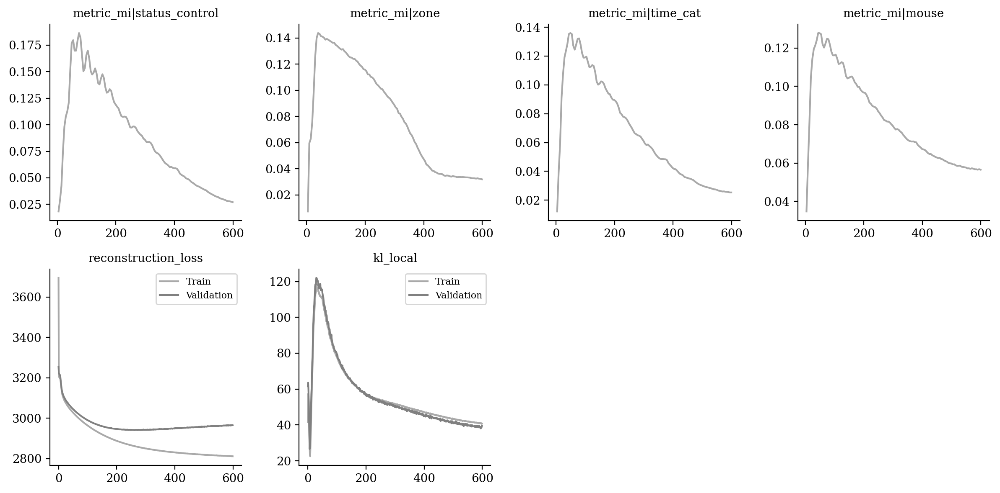

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

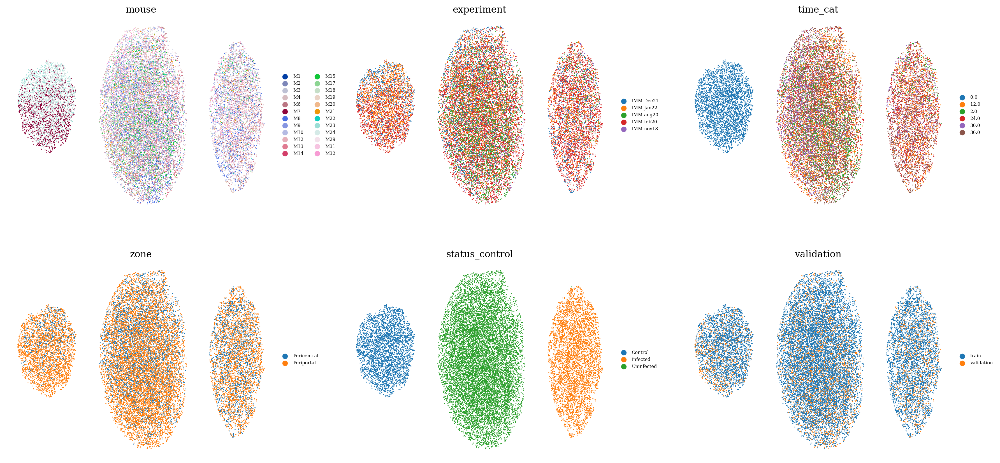

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

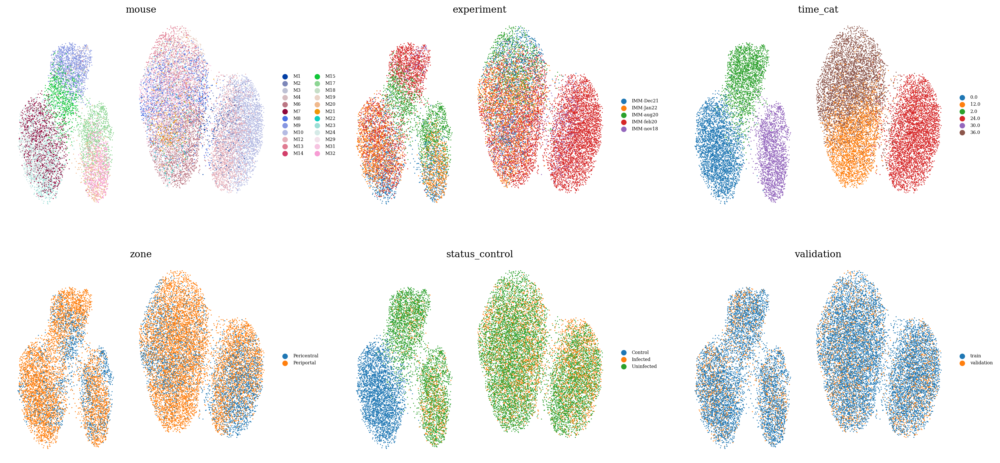

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

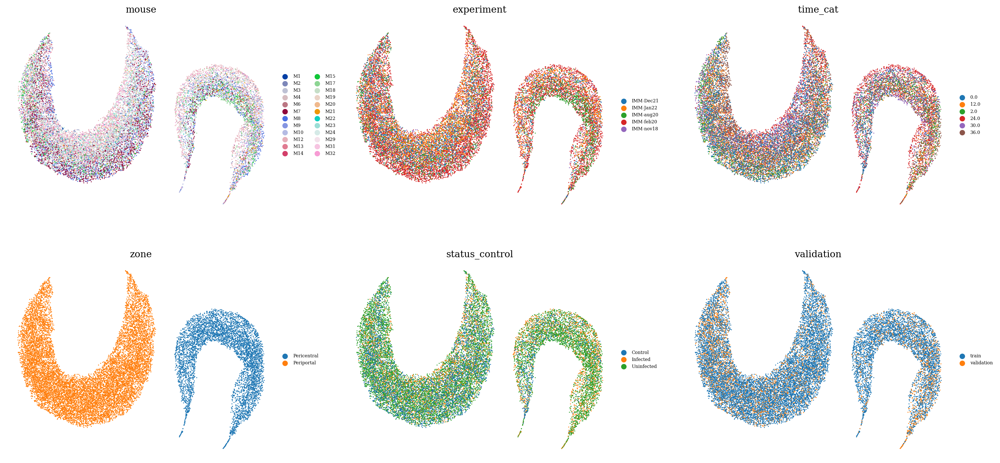

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

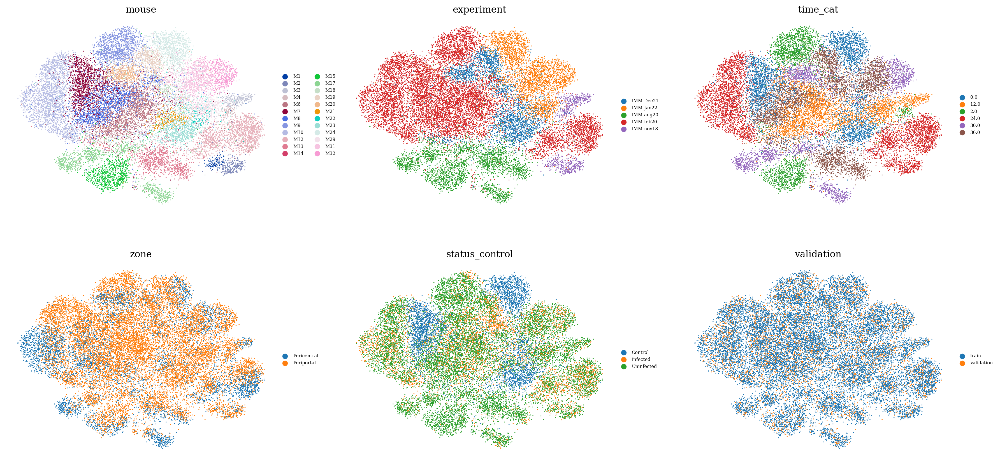

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

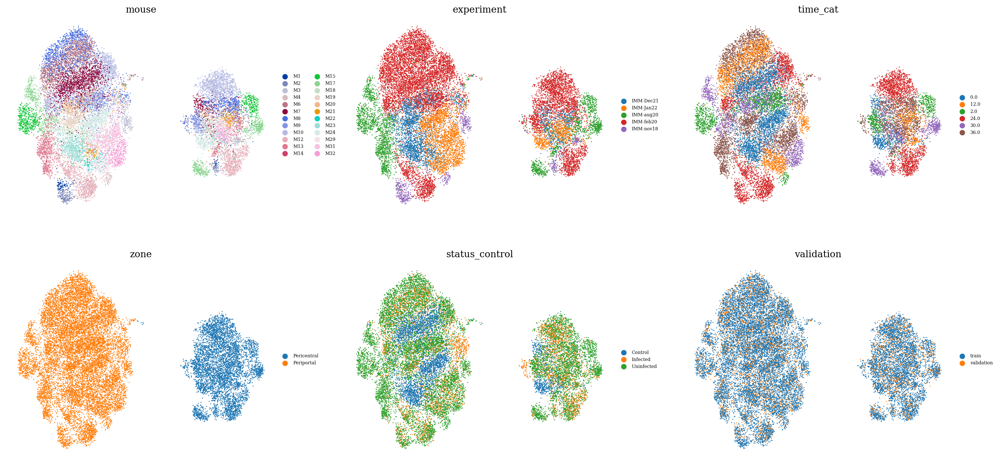

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

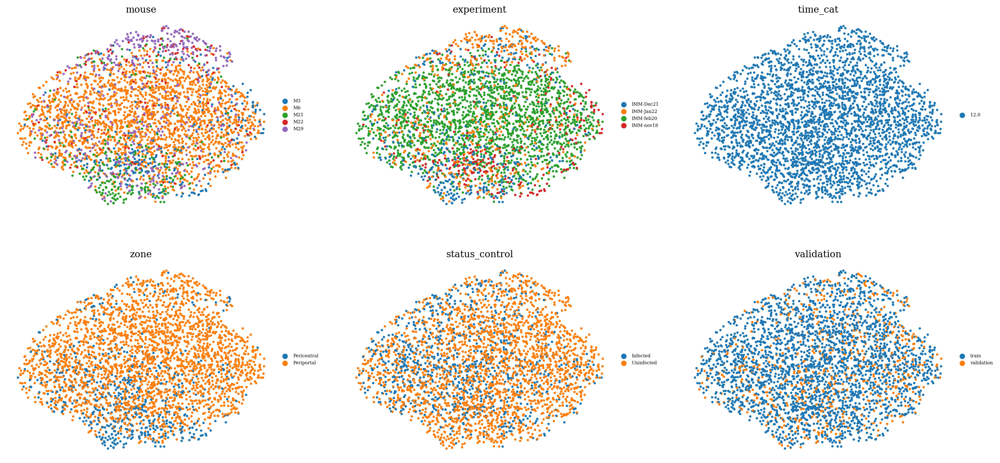

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )